***Geospatial Data Science Handbook***
- Author: Dr. Isam Al Jawarneh
- Copyright (c) [2024] [Isam Al Jawarneh]

https://towardsdatascience.com/data-101s-spatial-visualizations-and-analysis-in-python-with-folium-39730da2adf

https://github.com/justinm0rgan/citibike-heatmap

#Prepare: Install the needed packages

In [1]:
# Install Folium library for creating interactive maps
!pip install folium
# Install uszipcode library for accessing US ZIP Code data
!pip install uszipcode
# Install pygeohash library for encoding and decoding geographical coordinates into geohashes
%pip install pygeohash
# Install Geopandas library for working with geospatial data
!pip install geopandas


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.0/57.0 kB 4.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.1/77.1 kB 4.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 9.6 MB/s eta 0:00:00
  Created wheel for atomicwrites: filename=atomicwrites-1.4.1-py2.py3-none-any.whl size=6941 sha256=546c1a713c99bcad8ce614a1ee86c2faf3ab301b8057067d3d5c4faacef0122d
  Stored in directory: /root/.cache/pip/wheels/34/07/0b/33b15f68736109f72ea0bb2499521d87312b932620737447a2
Successfully built atomicwrites
  Attempting uninstall: SQLAlchemy
    Found existing installation: SQLAlchemy 2.0.29
    Uninstalling SQLAlchemy-2.0.29:
      Successfully uninstalled SQLAlchemy-2.0.29
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
ipython-sql 0.5.0 requires sqlalchemy>=2.0, but you have sqlalchemy 1.4

# Mount the drive

Mount the drive so that you can read the data from google drive

---



In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Import the Libraries

In [3]:
from pandas import Series, DataFrame # Import Series and DataFrame classes from pandas library
import pandas as pd # Import pandas library with alias pd
import numpy as np # Import numpy library with alias np
import plotly.graph_objs as go # Import graph objects module from plotly library with alias go
from IPython.display import Image # Import Image class from IPython.display module
import folium # Import folium library for creating interactive maps
from folium import IFrame # Import IFrame class from folium library
from folium.plugins import MarkerCluster # Import MarkerCluster plugin from folium.plugins module
from folium import plugins # Import plugins module from folium library
from datetime import datetime # Import datetime class from datetime module
import datetime as dt # Import datetime module with alias dt
import json # Import json module for working with JSON data
from scipy import stats # Import stats module from scipy library
import os # Import os module for interacting with the operating system
import matplotlib.pyplot as plt
import seaborn as sns

# CONFIG: Sampling Parameters

In [4]:
sampling_fraction = 0.6
geohash_precision = 6

# Loading Data & Analysis: Mobility Data

In [5]:
# Read the CSV file into a pandas DataFrame named "trips"
trips = pd.read_csv("/content/drive/MyDrive/Found. of DS Project/nyc_mobility/nyc1.csv")


In [6]:
#directoryPath = "/content/drive/MyDrive/Papers/dimensionality_reduction/datasets/NYC/trips/"

In [7]:
#Merge Multiple CSV Files in Python

In [8]:
'''file_path_1 ='/content/drive/MyDrive/Papers/dimensionality_reduction/datasets/NYC/pollution/NYC_Pilot1_PM.csv'
file_path_2 = "/content/drive/MyDrive/Papers/dimensionality_reduction/datasets/NYC/pollution/NYC_Pilot2_PM_Part1.csv"
file_path_3 = "/content/drive/MyDrive/Papers/dimensionality_reduction/datasets/NYC/pollution/NYC_Pilot2_PM_Part2.csv"
file_path_4 = "/content/drive/MyDrive/Papers/dimensionality_reduction/datasets/NYC/pollution/NYC_Pilot2_PM_Part3.csv"'''

'file_path_1 =\'/content/drive/MyDrive/Papers/dimensionality_reduction/datasets/NYC/pollution/NYC_Pilot1_PM.csv\'\nfile_path_2 = "/content/drive/MyDrive/Papers/dimensionality_reduction/datasets/NYC/pollution/NYC_Pilot2_PM_Part1.csv"\nfile_path_3 = "/content/drive/MyDrive/Papers/dimensionality_reduction/datasets/NYC/pollution/NYC_Pilot2_PM_Part2.csv"\nfile_path_4 = "/content/drive/MyDrive/Papers/dimensionality_reduction/datasets/NYC/pollution/NYC_Pilot2_PM_Part3.csv"'

In [9]:
'''import pandas as pd
files = [file_path_1, file_path_2,file_path_3,file_path_4]
trips = pd.DataFrame()
for file in files:
    data = pd.read_csv(file)
    trips = pd.concat([trips, data], axis=0)
#df.to_csv('nyc_pollution.csv', index=False)'''

"import pandas as pd\nfiles = [file_path_1, file_path_2,file_path_3,file_path_4]\ntrips = pd.DataFrame()\nfor file in files:\n    data = pd.read_csv(file)\n    trips = pd.concat([trips, data], axis=0)\n#df.to_csv('nyc_pollution.csv', index=False)"

In [10]:
# Return the type of the dataframe trips
type(trips)

pandas.core.frame.DataFrame

In [11]:
# Retrive the number of rows and number of columns in the dataframe trip
trips.shape

(1445285, 22)

In [12]:
# Retrieve the first 2 rows of the DataFrame trips to inspect its structure and content
trips.head(2)

,id,VendorID,lpep_pickup_datetime,Lpep_dropoff_datetime,Store_and_fwd_flag,RateCodeID,Pickup_longitude,Pickup_latitude,Dropoff_longitude,Dropoff_latitude,...,Fare_amount,Extra,MTA_tax,Tip_amount,Tolls_amount,Ehail_fee,improvement_surcharge,Total_amount,Payment_type,Trip_type
0,0,2,2016-01-01 00:29:24,2016-01-01 00:39:36,N,1,-73.928642,40.680611,-73.924278,40.698044,...,8.0,0.5,0.5,1.86,0.0,NaN,0.3,11.16,1,1.0
1,1,2,2016-01-01 00:19:39,2016-01-01 00:39:18,N,1,-73.952675,40.723175,-73.923920,40.761379,...,15.5,0.5,0.5,0.00,0.0,NaN,0.3,16.80,2,1.0


In [13]:
'''import glob
import pandas as pd

trips = pd.DataFrame()
for file_name in glob.glob(directoryPath+'*.csv'):
    x = pd.read_csv(file_name, low_memory=False)
    trips = pd.concat([trips,x],axis=0)'''
    #this is for multiple files

"import glob\nimport pandas as pd\n\ntrips = pd.DataFrame()\nfor file_name in glob.glob(directoryPath+'*.csv'):\n    x = pd.read_csv(file_name, low_memory=False)\n    trips = pd.concat([trips,x],axis=0)"

In [14]:
# Retrieve the number of columns in the DataFrame trips
columns=trips.shape[1]
print(columns)

# Retrieve the number of rows in the DataFrame trips
rows=trips.shape[0]
print(rows)

22
1445285


Convert datetime object column to datetime series

In [15]:
'''trips['time'] = pd.to_datetime(\
                trips['time'],dayfirst = True)
trips['time'] = pd.to_datetime(\
                trips['time'],dayfirst = True)'''


"trips['time'] = pd.to_datetime(                trips['time'],dayfirst = True)\ntrips['time'] = pd.to_datetime(                trips['time'],dayfirst = True)"

add columns month, time, day

# Remove erroneous coordinates (0,0) from the dataset - Mobility Data


In [16]:
# Rename the 'Pickup_longitude' column to 'longitude'
# Rename 'Pickup_latitude' column to 'latitude' in the DataFrame trips
# The 'inplace=True' parameter ensures that the changes are applied to the DataFrame itself
trips.rename(columns={'Pickup_longitude':'longitude', 'Pickup_latitude':'latitude'}, inplace=True)

In [17]:
# Filter the DataFrame trips to remove rows where the latitude is 0 and longitude is 0
trips = trips[(trips['latitude'] != 0 ) & (trips['longitude']!=0 )]

### Check the size before and after the filter

In [18]:
#Before the filter
print("Before filtering:", rows)

#After the filter
rows2=trips.shape[0]
print("After filtering: ", rows2)

Before filtering: 1445285
After filtering:  1442776


# Geohash - Mobility Data

### Import the libraries

In [19]:
!pip install pygeohash

In [20]:
import pygeohash as gh  # Import pygeohash library with alias gh for encoding and decoding geographic coordinates into geohashes
import geopandas as gpd  # Import the geopandas library with alias gpd for working with geospatial data

### Generate geohash for each tuple (long, lat)

In [21]:
# Measure the execution time of the code within this cell
%%time

# Encode latitude and longitude coordinates into geohashes and assign them to a new column 'geohash' in the DataFrame trips
# The lambda function applies the encoding operation to each row of the DataFrame using the specified geohash precision
trips['geohash'] = trips.apply(lambda x: gh.encode(x.latitude, x.longitude, precision=geohash_precision), axis=1)


CPU times: user 54.5 s, sys: 1.2 s, total: 55.7 s
Wall time: 1min 9s


In [22]:
print(trips.geohash)

0          dr5rmt
1          dr5rtj
2          dr5rks
3          dr5rk7
4          dr5rky
            ...  
1445280    dr5x83
1445281    dr5rt5
1445282    dr5rtn
1445283    dr72jn
1445284    dr5ry9
Name: geohash, Length: 1442776, dtype: object


In [23]:
print(trips.Dropoff_longitude[4])

-73.94071960449219


In [24]:
# Measure the average execution time of the trips.head(2) operation
%timeit trips.head(2)

28.2 µs ± 8.62 µs per loop (mean ± std. dev. of 7 runs, 10000 loops each)


In [25]:
# Display number of rows
trips.shape[0]

1442776

In [26]:
# Display the first 2 rows
trips.head(2)

,id,VendorID,lpep_pickup_datetime,Lpep_dropoff_datetime,Store_and_fwd_flag,RateCodeID,longitude,latitude,Dropoff_longitude,Dropoff_latitude,...,Extra,MTA_tax,Tip_amount,Tolls_amount,Ehail_fee,improvement_surcharge,Total_amount,Payment_type,Trip_type,geohash
0,0,2,2016-01-01 00:29:24,2016-01-01 00:39:36,N,1,-73.928642,40.680611,-73.924278,40.698044,...,0.5,0.5,1.86,0.0,NaN,0.3,11.16,1,1.0,dr5rmt
1,1,2,2016-01-01 00:19:39,2016-01-01 00:39:18,N,1,-73.952675,40.723175,-73.923920,40.761379,...,0.5,0.5,0.00,0.0,NaN,0.3,16.80,2,1.0,dr5rtj


### Convert trips to GeoPandas

In [27]:
# Return the type of the dataframe trip
type(trips)

pandas.core.frame.DataFrame

In [28]:
# Convert to Geopandas Geodataframe
%%time

# Create a GeoDataFrame gdf_trips from the DataFrame trips, specifying the geometry column using longitude and latitude coordinates
gdf_trips = gpd.GeoDataFrame(trips, geometry=gpd.points_from_xy(trips.longitude, trips.latitude))

CPU times: user 2.27 s, sys: 280 ms, total: 2.55 s
Wall time: 2.58 s


In [29]:
#gdf2_trips = gpd.GeoDataFrame(trips, geometry=0)

In [30]:
# Determine the type of object represented by the variable gdf_trips
type(gdf_trips)

geopandas.geodataframe.GeoDataFrame

In [31]:
# Print the Coordinate Reference System (CRS) of the GeoDataFrame gdf_trips
#gdf_trips.head(2)
print(gdf_trips.crs)


None


In [32]:
# RUN the cell before
# Sample a fraction of the GeoDataFrame gdf_trips
# The sampling fraction determines the proportion of rows to be randomly sampled from the GeoDataFrame

gdf_trips=gdf_trips.sample(frac=sampling_fraction) # sampling_fraction = 0.6

In [33]:
trips.head(1)

,id,VendorID,lpep_pickup_datetime,Lpep_dropoff_datetime,Store_and_fwd_flag,RateCodeID,longitude,latitude,Dropoff_longitude,Dropoff_latitude,...,Extra,MTA_tax,Tip_amount,Tolls_amount,Ehail_fee,improvement_surcharge,Total_amount,Payment_type,Trip_type,geohash
0,0,2,2016-01-01 00:29:24,2016-01-01 00:39:36,N,1,-73.928642,40.680611,-73.924278,40.698044,...,0.5,0.5,1.86,0.0,NaN,0.3,11.16,1,1.0,dr5rmt


In [34]:
gdf_trips.head(1)

,id,VendorID,lpep_pickup_datetime,Lpep_dropoff_datetime,Store_and_fwd_flag,RateCodeID,longitude,latitude,Dropoff_longitude,Dropoff_latitude,...,MTA_tax,Tip_amount,Tolls_amount,Ehail_fee,improvement_surcharge,Total_amount,Payment_type,Trip_type,geohash,geometry
1206024,1206024,2,2016-01-27 18:48:44,2016-01-27 19:17:51,N,1,-73.952599,40.811646,-73.977547,40.761353,...,0.5,4.86,0.0,NaN,0.3,29.16,1,1.0,dr72jj,POINT (-73.95260 40.81165)


In [35]:
print(gdf_trips)

              id  VendorID lpep_pickup_datetime Lpep_dropoff_datetime  \
1206024  1206024         2  2016-01-27 18:48:44   2016-01-27 19:17:51   
1398868  1398868         2  2016-01-31 01:21:34   2016-01-31 01:30:36   
1392277  1392277         1  2016-01-30 23:45:31   2016-01-30 23:55:51   
832005    832005         1  2016-01-18 08:45:48   2016-01-18 09:02:17   
62712      62712         2  2016-01-01 23:27:02   2016-01-01 23:31:32   
...          ...       ...                  ...                   ...   
530535    530535         2  2016-01-12 07:34:48   2016-01-12 07:57:50   
696204    696204         2  2016-01-15 19:59:17   2016-01-15 20:23:12   
225606    225606         2  2016-01-05 17:35:58   2016-01-05 17:44:05   
1142062  1142062         2  2016-01-26 09:02:02   2016-01-26 09:32:12   
415514    415514         2  2016-01-09 18:35:25   2016-01-09 18:48:58   

        Store_and_fwd_flag  RateCodeID  longitude   latitude  \
1206024                  N           1 -73.952599  40.81164

<Axes: >

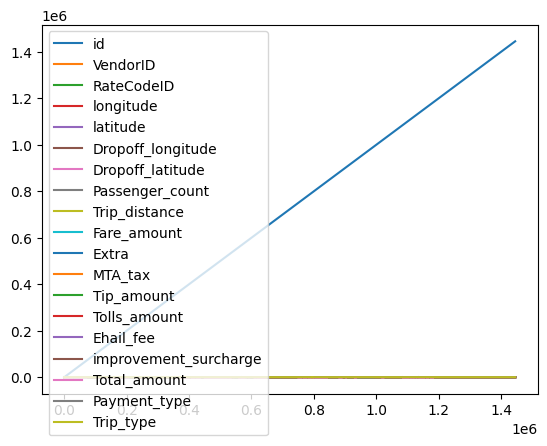

In [36]:
trips.plot()

<Axes: >

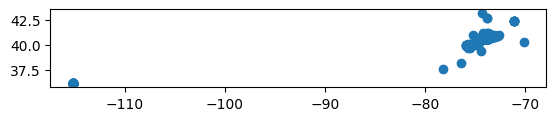

In [37]:
gdf_trips.plot()

In [38]:
# Print the Coordinate Reference System (CRS) of the GeoDataFrame gdf_trips - after the sampling (it should stay the same)
print(gdf_trips.crs)

None


In [39]:
# The CRS for trips should remain geographic 4326
gdf_trips = gdf_trips.set_crs('epsg:4326')
print(gdf_trips)

              id  VendorID lpep_pickup_datetime Lpep_dropoff_datetime  \
1206024  1206024         2  2016-01-27 18:48:44   2016-01-27 19:17:51   
1398868  1398868         2  2016-01-31 01:21:34   2016-01-31 01:30:36   
1392277  1392277         1  2016-01-30 23:45:31   2016-01-30 23:55:51   
832005    832005         1  2016-01-18 08:45:48   2016-01-18 09:02:17   
62712      62712         2  2016-01-01 23:27:02   2016-01-01 23:31:32   
...          ...       ...                  ...                   ...   
530535    530535         2  2016-01-12 07:34:48   2016-01-12 07:57:50   
696204    696204         2  2016-01-15 19:59:17   2016-01-15 20:23:12   
225606    225606         2  2016-01-05 17:35:58   2016-01-05 17:44:05   
1142062  1142062         2  2016-01-26 09:02:02   2016-01-26 09:32:12   
415514    415514         2  2016-01-09 18:35:25   2016-01-09 18:48:58   

        Store_and_fwd_flag  RateCodeID  longitude   latitude  \
1206024                  N           1 -73.952599  40.81164

In [40]:
# Display the shape of the GeoDataFrame gdf_trips
gdf_trips.shape

(865666, 24)

In [41]:
# Display the first 2 rows of the GeoDataFrame gdf_trips
gdf_trips.head(2)

,id,VendorID,lpep_pickup_datetime,Lpep_dropoff_datetime,Store_and_fwd_flag,RateCodeID,longitude,latitude,Dropoff_longitude,Dropoff_latitude,...,MTA_tax,Tip_amount,Tolls_amount,Ehail_fee,improvement_surcharge,Total_amount,Payment_type,Trip_type,geohash,geometry
1206024,1206024,2,2016-01-27 18:48:44,2016-01-27 19:17:51,N,1,-73.952599,40.811646,-73.977547,40.761353,...,0.5,4.86,0.0,NaN,0.3,29.16,1,1.0,dr72jj,POINT (-73.95260 40.81165)
1398868,1398868,2,2016-01-31 01:21:34,2016-01-31 01:30:36,N,1,-73.972336,40.685459,-73.948418,40.691616,...,0.5,2.94,0.0,NaN,0.3,12.74,1,1.0,dr5rkw,POINT (-73.97234 40.68546)


it additionally trips now has the geometry column

### Convert polygons to GeoPandas

In [42]:
# BASELINE: original Neighbourhoods

# Define the file path to the GeoJSON file containing NYC neighborhood polygons
geojson_file = "/content/drive/MyDrive/Found. of DS Project/nyc_polygon.geojson"

# Read the GeoJSON file and create a GeoDataFrame named neighborhoods_original
neighborhoods_original = gpd.read_file(geojson_file)

In [43]:
# Display the shape of the GeoDataFrame neighborhoods_original (rows, columns)
neighborhoods_original.shape

(310, 5)

In [44]:
# Display the first 2 rows of the GeoDataFrame neighborhoods_original
neighborhoods_original.head(2)

,neighborhood,boroughCode,borough,@id,geometry
0,Allerton,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-73.84860 40.87167, -73.84582 40.870..."
1,Alley Pond Park,4,Queens,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-73.74333 40.73888, -73.74371 40.739..."


In [45]:
# Display the first 2 rows of the GeoDataFrame gdf_trips
gdf_trips.head(2)

,id,VendorID,lpep_pickup_datetime,Lpep_dropoff_datetime,Store_and_fwd_flag,RateCodeID,longitude,latitude,Dropoff_longitude,Dropoff_latitude,...,MTA_tax,Tip_amount,Tolls_amount,Ehail_fee,improvement_surcharge,Total_amount,Payment_type,Trip_type,geohash,geometry
1206024,1206024,2,2016-01-27 18:48:44,2016-01-27 19:17:51,N,1,-73.952599,40.811646,-73.977547,40.761353,...,0.5,4.86,0.0,NaN,0.3,29.16,1,1.0,dr72jj,POINT (-73.95260 40.81165)
1398868,1398868,2,2016-01-31 01:21:34,2016-01-31 01:30:36,N,1,-73.972336,40.685459,-73.948418,40.691616,...,0.5,2.94,0.0,NaN,0.3,12.74,1,1.0,dr5rkw,POINT (-73.97234 40.68546)


### Spatial Analysis and Join Operations with GeoDataFrames
Keeping geometry column from both dataframes when applying sjoin() using GeoPandas
this is so because later on we group by NAME(district in Shenzhen)
also, the CRS (coordinate reference system) is 3857 in this case which is a projected CRS not geographic CRS, to calculate the distance corercctly between centroids
https://gis.stackexchange.com/questions/393387/keeping-geometry-column-from-both-dataframes-when-applying-sjoin-using-geopand

In [46]:
# Convert the geometry column to EPSG:3857 CRS for accurate spatial analysis.
neighborhoods_original['geometryn'] = neighborhoods_original.geometry.to_crs("epsg:3857")

In [47]:
# Retrieve the coordinate reference system (CRS) information from the GeoDataFrame gdf_trips
gdf_trips.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [48]:
# Retrieve the coordinate reference system (CRS) information from the GeoDataFrame neighborhoods_original
neighborhoods_original.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [49]:
# Retrieve the coordinate reference system (CRS) information from the 'geometryn' column of the GeoDataFrame neighborhoods_original
neighborhoods_original.geometryn.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World between 85.06°S and 85.06°N.
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [50]:
%%time
# Perform a spatial join between gdf_trips and neighborhoods_original, considering trips that are within neighborhood polygons.

#BASELINE
# we join by sjoin, but we have geohash so, we sample stratified by geohash
# so, we join only to get the metrics but the stratified sampling is based on the fine-grained division (geohash in this case)

# Store the result of the spatial join in the variable sjoined_trips_original.
sjoined_trips_original = gpd.sjoin(gdf_trips, neighborhoods_original, predicate="within")

CPU times: user 7.85 s, sys: 780 ms, total: 8.63 s
Wall time: 8.66 s


In [51]:
# Display the first 2 rows of the resulting GeoDataFrame.
sjoined_trips_original.head(2)

,id,VendorID,lpep_pickup_datetime,Lpep_dropoff_datetime,Store_and_fwd_flag,RateCodeID,longitude,latitude,Dropoff_longitude,Dropoff_latitude,...,Payment_type,Trip_type,geohash,geometry,index_right,neighborhood,boroughCode,borough,@id,geometryn
1206024,1206024,2,2016-01-27 18:48:44,2016-01-27 19:17:51,N,1,-73.952599,40.811646,-73.977547,40.761353,...,1,1.0,dr72jj,POINT (-73.95260 40.81165),128,Harlem,1,Manhattan,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8230358.427 4987026.661, -8230342.4..."
336223,336223,1,2016-01-08 08:01:22,2016-01-08 08:07:36,N,1,-73.952301,40.810753,-73.940010,40.805561,...,1,1.0,dr72jj,POINT (-73.95230 40.81075),128,Harlem,1,Manhattan,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8230358.427 4987026.661, -8230342.4..."


In [52]:
# Retrieve the type of the variable sjoined_trips_original, indicating the data type of the object it refers to.
type(sjoined_trips_original)

geopandas.geodataframe.GeoDataFrame

In [53]:
# Counting unique values
n = len(pd.unique(sjoined_trips_original['neighborhood']))
print("No.of.unique name values :", n)

No.of.unique name values : 217


In [54]:
# Retrieve the shape of the sjoined_trips_original GeoDataFrame, which indicates the number of rows and columns in the dataset.
sjoined_trips_original.shape

(864932, 30)

In [55]:
# Retrieve the data types of columns in the sjoined_trips_original GeoDataFrame, indicating the data type of each attribute or column.
sjoined_trips_original.dtypes

id                          int64
VendorID                    int64
lpep_pickup_datetime       object
Lpep_dropoff_datetime      object
Store_and_fwd_flag         object
RateCodeID                  int64
longitude                 float64
latitude                  float64
Dropoff_longitude         float64
Dropoff_latitude          float64
Passenger_count             int64
Trip_distance             float64
Fare_amount               float64
Extra                     float64
MTA_tax                   float64
Tip_amount                float64
Tolls_amount              float64
Ehail_fee                 float64
improvement_surcharge     float64
Total_amount              float64
Payment_type                int64
Trip_type                 float64
geohash                    object
geometry                 geometry
index_right                 int64
neighborhood               object
boroughCode                object
borough                    object
@id                        object
geometryn     

# SAMPLING AND MAP GENERATION

### SAMPLING - PERFORMANCE

###  Sampling by Geohash with Variable Sampling Fraction

In [56]:
%%time
# Sampling by geohash change fraction sampling rate
# Group the spatially joined data 'sjoined_trips_original' by neighborhood
# Then within each neighborhood group, sample a fraction of the data based on the specified 'sampling_fraction'.

sampled_geohash_data_base= sjoined_trips_original.groupby('neighborhood').apply(lambda x: x.sample(frac=sampling_fraction)) #sampling_fraction = 0.6
# The resulting sampled data is stored in the 'sampled_geohash_data_base' variable.

CPU times: user 4.02 s, sys: 23.6 ms, total: 4.04 s
Wall time: 4.11 s


In [57]:
# Retrieve the shape of the sampled_geohash_data_base DataFrame, indicating the number of rows and columns in the dataset.
sampled_geohash_data_base.shape

(518959, 30)

In [58]:
# Print the first two rows
sampled_geohash_data_base.head(2)

id  VendorID lpep_pickup_datetime  \
neighborhood                                                   
Allerton     1090243  1090243         2  2016-01-25 00:18:27   
             223662    223662         2  2016-01-05 16:42:03   

                     Lpep_dropoff_datetime Store_and_fwd_flag  RateCodeID  \
neighborhood                                                                
Allerton     1090243   2016-01-25 00:18:46                  N           5   
             223662    2016-01-05 17:05:22                  N           5   

                      longitude   latitude  Dropoff_longitude  \
neighborhood                                                    
Allerton     1090243 -73.854584  40.871193         -73.853683   
             223662  -73.865250  40.857338         -73.909370   

                      Dropoff_latitude  ...  Payment_type  Trip_type  geohash  \
neighborhood                            ...                                     
Allerton     1090243         40.871181  ...             1        2.0   dr72x2   
             223662          40.879204  ...             2        2.0   dr72rj   

                                        geometry  index_right  neighborhood  \
neighborhood                                                                  
Allerton     1090243  POINT (-73.85458 40.87119)            0      Allerton   
             223662   POINT (-73.86525 40.85734)            0      Allerton   

                      boroughCode  borough  \
neighborhood                                 
Allerton     1090243            2    Bronx   
             223662             2    Bronx   

                                                                    @id  \
neighborhood                                                              
Allerton     1090243  http://nyc.pediacities.com/Resource/Neighborho...   
             223662   http://nyc.pediacities.com/Resource/Neighborho...   

                                                              geometryn  
neighborhood                                                             
Allerton     1090243  POLYGON ((-8220788.214 4993431.406, -8220479.3...  
             223662   POLYGON ((-8220788.214 4993431.406, -8220479.3...  

[2 rows x 30 columns]

In [59]:
# Print the column names of the sampled_geohash_data_base DataFrame, showing the attributes present in the dataset.
print(sampled_geohash_data_base.columns)

Index(['id', 'VendorID', 'lpep_pickup_datetime', 'Lpep_dropoff_datetime',
       'Store_and_fwd_flag', 'RateCodeID', 'longitude', 'latitude',
       'Dropoff_longitude', 'Dropoff_latitude', 'Passenger_count',
       'Trip_distance', 'Fare_amount', 'Extra', 'MTA_tax', 'Tip_amount',
       'Tolls_amount', 'Ehail_fee', 'improvement_surcharge', 'Total_amount',
       'Payment_type', 'Trip_type', 'geohash', 'geometry', 'index_right',
       'neighborhood', 'boroughCode', 'borough', '@id', 'geometryn'],
      dtype='object')


In [60]:
#take only readings greater than specific threshold to count reading in each polygon greater than that threshold
#sampled_geohash_data_base = sampled_geohash_data_base[sampled_geohash_data_base.pm25>= 3 ]

In [61]:
# counting unique values
n = len(pd.unique(sampled_geohash_data_base['neighborhood']))
print("No.of.unique name values :", n)

No.of.unique name values : 217


### Sampling Entire Fractions of Grouped Data by Neighborhood

In [62]:
%%time
# Original

# Group the spatially joined data 'sjoined_trips_original' by neighborhood, then within each neighborhood group, sample the entire fraction of the data (frac=1).
sampled_geohash_data_original = sjoined_trips_original.groupby('neighborhood').apply(lambda x: x.sample(frac=1))
# The resulting sampled data is stored in the 'sampled_geohash_data_original' variable

CPU times: user 3.88 s, sys: 152 ms, total: 4.03 s
Wall time: 4.06 s


In [63]:
# Retrieve the shape of the sampled_geohash_data_base DataFrame, indicating the number of rows and columns in the dataset.
sampled_geohash_data_original.shape

(864932, 30)

In [64]:
# Print the first two rows
sampled_geohash_data_original.head(2)

id  VendorID lpep_pickup_datetime  \
neighborhood                                                 
Allerton     360666  360666         2  2016-01-08 19:09:16   
             231433  231433         2  2016-01-05 19:23:04   

                    Lpep_dropoff_datetime Store_and_fwd_flag  RateCodeID  \
neighborhood                                                               
Allerton     360666   2016-01-08 19:15:28                  N           1   
             231433   2016-01-05 19:29:17                  N           5   

                     longitude   latitude  Dropoff_longitude  \
neighborhood                                                   
Allerton     360666 -73.867500  40.865585         -73.881134   
             231433 -73.868256  40.865116         -73.866737   

                     Dropoff_latitude  ...  Payment_type  Trip_type  geohash  \
neighborhood                           ...                                     
Allerton     360666         40.866611  ...             1        1.0   dr72rp   
             231433         40.876465  ...             2        2.0   dr72rp   

                                       geometry  index_right  neighborhood  \
neighborhood                                                                 
Allerton     360666  POINT (-73.86750 40.86559)            0      Allerton   
             231433  POINT (-73.86826 40.86512)            0      Allerton   

                     boroughCode  borough  \
neighborhood                                
Allerton     360666            2    Bronx   
             231433            2    Bronx   

                                                                   @id  \
neighborhood                                                             
Allerton     360666  http://nyc.pediacities.com/Resource/Neighborho...   
             231433  http://nyc.pediacities.com/Resource/Neighborho...   

                                                             geometryn  
neighborhood                                                            
Allerton     360666  POLYGON ((-8220788.214 4993431.406, -8220479.3...  
             231433  POLYGON ((-8220788.214 4993431.406, -8220479.3...  

[2 rows x 30 columns]

In [65]:
# Print the column names of the sampled_geohash_data_original DataFrame, showing the attributes present in the dataset.
print(sampled_geohash_data_original.columns)

Index(['id', 'VendorID', 'lpep_pickup_datetime', 'Lpep_dropoff_datetime',
       'Store_and_fwd_flag', 'RateCodeID', 'longitude', 'latitude',
       'Dropoff_longitude', 'Dropoff_latitude', 'Passenger_count',
       'Trip_distance', 'Fare_amount', 'Extra', 'MTA_tax', 'Tip_amount',
       'Tolls_amount', 'Ehail_fee', 'improvement_surcharge', 'Total_amount',
       'Payment_type', 'Trip_type', 'geohash', 'geometry', 'index_right',
       'neighborhood', 'boroughCode', 'borough', '@id', 'geometryn'],
      dtype='object')


In [66]:
# Counting unique values
n = len(pd.unique(sampled_geohash_data_original['neighborhood']))
print("No.of.unique name values :", n)

No.of.unique name values : 217


In [67]:
# Sampling by Geohash with Variable Sampling Fraction
sampled_geohash_data_base.shape

(518959, 30)

In [68]:
# Sampling Entire Fractions of Grouped Data by Neighborhood
sampled_geohash_data_original.shape

(864932, 30)

### END SAMPLING

### Choropleth Maps
Choropleth maps are thematic maps where areas (such as regions, countries, or administrative boundaries) are shaded or patterned in proportion to the value of a variable being represented.

In [69]:
# Sampled data scenario #2
# Sampling by Geohash with Variable Sampling Fraction

# Compute the frequency of occurrences of each unique value in the 'neighborhood' column of the 'sampled_geohash_data_base' DataFrame
shenzhen_taxi_pickup_sample2= sampled_geohash_data_base['neighborhood'].value_counts() # The result is stored in 'shenzhen_taxi_pickup_sample2'

# Reset the index of the 'shenzhen_taxi_pickup_sample2', converting the current index into a new column.
shenzhen_taxi_pickup_sample2 = shenzhen_taxi_pickup_sample2.reset_index()

# Rename the columns of the 'shenzhen_taxi_pickup_sample2' DataFrame to 'neighborhood' and 'count'
shenzhen_taxi_pickup_sample2.columns = ['neighborhood','count']

# Convert the 'neighborhood' column of the 'shenzhen_taxi_pickup_sample2' DataFrame to string type
shenzhen_taxi_pickup_sample2['neighborhood'] = shenzhen_taxi_pickup_sample2['neighborhood'].astype(str)

In [70]:
# Original data

# Compute the frequency of occurrences of each unique value in the 'neighborhood' column of the 'sjoined_trips_original' DataFrame
shenzhen_taxi_pickup_original= sjoined_trips_original['neighborhood'].value_counts() # The result is stored in 'shenzhen_taxi_pickup_original'.

# Reset the index of the 'shenzhen_taxi_pickup_original' Series/DataFrame,  converting the current index into a new column.
shenzhen_taxi_pickup_original = shenzhen_taxi_pickup_original.reset_index()

# Rename the columns of the 'shenzhen_taxi_pickup_original' DataFrame to 'neighborhood' and 'count'.
shenzhen_taxi_pickup_original.columns = ['neighborhood','count']

# Convert the 'neighborhood' column of the 'shenzhen_taxi_pickup_original' DataFrame to string type.
shenzhen_taxi_pickup_original['neighborhood'] = shenzhen_taxi_pickup_original['neighborhood'].astype(str)

In [71]:
# Display the first 6 rows of the Shenzhen_taxi_pickup_original
shenzhen_taxi_pickup_original.head(6)

,neighborhood,count
0,Harlem,94684
1,East Harlem,84757
2,Williamsburg,70764
3,Astoria,44024
4,Elmhurst,34941
5,Bedford-Stuyvesant,33821


In [72]:
# Create a choropleth map visualizing the distribution of taxi pickups across neighborhoods in Shenzhen - using original data

# Reference geo-map
shenzhen_taxi_pickup_original["neighborhood"].astype(str)

# Define the file path to the GeoJSON file containing neighborhood polygons
geo_path = r'/content/drive/MyDrive/Found. of DS Project/nyc_polygon.geojson'

# Define the scale for the heatmap based on specified threshold percentages
heatmap_scale = list()
threshold = [10,20,50,70,85,100]

for i in threshold :
    heatmap_scale.append(int(shenzhen_taxi_pickup_original['count'].max() * (i/100.0)))

# Initialize a Folium map centered on Shenzhen with a specified zoom level
map_shenzhen_taxi_pickup_sample = folium.Map(location=[40.730610, -73.935242], zoom_start=10)

# Create a choropleth layer on the Folium map using GeoJSON data and pickup count data
map_shenzhen_taxi_pickup_sample.choropleth(geo_data=geo_path, data=shenzhen_taxi_pickup_original, \
                data_out = 'nyc_zip_test.json',
             columns=['neighborhood', 'count'],
             #threshold_scale= heatmap_scale,
             key_on='feature.properties.neighborhood',
             fill_color='YlOrRd', fill_opacity=0.9, line_opacity=0.9,nan_fill_color='white',
             legend_name='Number of Pickups')

/usr/local/lib/python3.10/dist-packages/folium/folium.py:465: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


In [73]:
# Display the choropleth map generated using Folium
map_shenzhen_taxi_pickup_sample

In [74]:
# Create a choropleth map visualizing the distribution of taxi pickups across neighborhoods in Shenzhen - using sampled data (variable sampling fraction)

# Base geo-map (without Douglas Algorithm)

# Reference geo-map
shenzhen_taxi_pickup_sample2["neighborhood"].astype(str)

# Define the file path to the GeoJSON file containing neighborhood polygons
geo_path = r'/content/drive/MyDrive/Found. of DS Project/nyc_polygon.geojson'

# Define the scale for the heatmap based on specified threshold percentages
heatmap_scale = list()
threshold = [10,20,50,70,85,100]
for i in threshold :
    heatmap_scale.append(int(shenzhen_taxi_pickup_sample2['count'].max() * (i/100.0)))

# Initialize a Folium map centered on Shenzhen with a specified zoom level
map_shenzhen_taxi_pickup_sample = folium.Map(location=[40.730610, -73.935242], zoom_start=10)

# Create a choropleth layer on the Folium map using GeoJSON data and pickup count data
map_shenzhen_taxi_pickup_sample.choropleth(geo_data=geo_path, data=shenzhen_taxi_pickup_sample2, \
                data_out = 'nyc_zip_test.json',
             columns=['neighborhood', 'count'],
             #threshold_scale= heatmap_scale,
             key_on='feature.properties.neighborhood',
             fill_color='YlOrRd', fill_opacity=0.9, line_opacity=0.9,nan_fill_color='white',
             legend_name='Number of Pickups')

/usr/local/lib/python3.10/dist-packages/folium/folium.py:465: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


fill_color (string, optional) – Area fill color, defaults to blue. Can pass a hex code, color name, or if you are binding data, one of the following color brewer palettes: ‘BuGn’, ‘BuPu’, ‘GnBu’, ‘OrRd’, ‘PuBu’, ‘PuBuGn’, ‘PuRd’, ‘RdPu’, ‘YlGn’, ‘YlGnBu’, ‘YlOrBr’, and ‘YlOrRd’.

In [75]:
# Display the choropleth map generated using Folium
map_shenzhen_taxi_pickup_sample

### END Choropleth Map generation

### Heatmap
A heatmap is a graphical representation of data in which values are depicted using a range of colors

### Heatmap (Longitude and Latitude Vs.	Count)
A heatmap is a graphical representation of data in which values are depicted using a range of colors

In [76]:
# Import the HeatMap class from the folium.plugins module
from folium.plugins import HeatMap

In [77]:
# Display the data types of each column in the DataFrame sjoined_trips_original
sjoined_trips_original.dtypes

id                          int64
VendorID                    int64
lpep_pickup_datetime       object
Lpep_dropoff_datetime      object
Store_and_fwd_flag         object
RateCodeID                  int64
longitude                 float64
latitude                  float64
Dropoff_longitude         float64
Dropoff_latitude          float64
Passenger_count             int64
Trip_distance             float64
Fare_amount               float64
Extra                     float64
MTA_tax                   float64
Tip_amount                float64
Tolls_amount              float64
Ehail_fee                 float64
improvement_surcharge     float64
Total_amount              float64
Payment_type                int64
Trip_type                 float64
geohash                    object
geometry                 geometry
index_right                 int64
neighborhood               object
boroughCode                object
borough                    object
@id                        object
geometryn     

In [78]:
# Group the data by neighborhood, aggregating longitude and latitude values while counting the occurrences of each neighborhood
heatmap_data = sjoined_trips_original[['longitude','latitude','neighborhood']].groupby(['neighborhood'], as_index=False).agg({'longitude': 'first', 'latitude': 'first','neighborhood':'count'})


In [79]:
# Rename the 'neighborhood' column to 'count' in the DataFrame heatmap_data
heatmap_data.rename(columns={'neighborhood': 'count'}, inplace=True)

In [80]:
# Sort the DataFrame heatmap_data by the 'count' column in descending order
new_heatmap_data = heatmap_data.sort_values(by='count', ascending=False) # The result is stored in new_heatmap_data

In [81]:
# Display the first two rows of the new_heatmap_data
new_heatmap_data.head(2)

,longitude,latitude,count
97,-73.952599,40.811646,94684
61,-73.942734,40.786049,84757


In [82]:
# Convert the DataFrame new_heatmap_data to a list
heatmap_data1 = new_heatmap_data.values.tolist()

In [83]:
# Display the data types of columns in the DataFrame trips
trips.dtypes

id                         int64
VendorID                   int64
lpep_pickup_datetime      object
Lpep_dropoff_datetime     object
Store_and_fwd_flag        object
RateCodeID                 int64
longitude                float64
latitude                 float64
Dropoff_longitude        float64
Dropoff_latitude         float64
Passenger_count            int64
Trip_distance            float64
Fare_amount              float64
Extra                    float64
MTA_tax                  float64
Tip_amount               float64
Tolls_amount             float64
Ehail_fee                float64
improvement_surcharge    float64
Total_amount             float64
Payment_type               int64
Trip_type                float64
geohash                   object
dtype: object

In [84]:
# Assigning a value of 1 to a new column 'count' in the DataFrame trips - 1 is added to each row in the column
trips['count'] = 1

In [85]:
# Randomly sample 10,000 rows from the 'trips' DataFrame, selecting only the columns 'latitude', 'longitude', and 'count' for each sampled row
trips[['latitude', 'longitude', 'count']].sample(n=10000)

,latitude,longitude,count
744469,40.753735,-73.923584,1
1232707,40.681568,-73.998520,1
1063579,40.749367,-73.869560,1
98040,40.840359,-73.920998,1
569595,40.714115,-73.959541,1
...,...,...,...
855773,40.804001,-73.954445,1
977664,40.812775,-73.906647,1
230563,40.730415,-73.862358,1
485208,40.749092,-73.869835,1


In [86]:
# Calculate the length of the list obtained after grouping the sampled trips DataFrame by latitude and longitude, summing up the counts, and converting it to a list of values
len(trips[['latitude', 'longitude', 'count']].sample(n=10000).groupby(['latitude', 'longitude']).sum().reset_index().values.tolist())

9980

In [87]:
# Define a function to generate a base map using Folium with default location and zoom level
def generateBaseMap(default_location=[40.7306, -73.935], default_zoom_start=11):

    # Create a Folium map with the specified default location and zoom level
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)

    # Return the generated base map
    return base_map


In [88]:
# Generate a base map using the generateBaseMap function
base_map = generateBaseMap()

# Create a HeatMap layer using the sampled data and add it to the base map
HeatMap(data=trips[['latitude', 'longitude', 'count']].sample(n=10000).groupby(['latitude', 'longitude']).sum().reset_index().values.tolist(),
        radius=8, max_zoom=13).add_to(base_map)

In [89]:
# Display the base map with the HeatMap layer
base_map

In [90]:
# Add a click-for-marker functionality to the base map
base_map.add_child(folium.ClickForMarker(popup='Potential Location'))


### Heatmap (Longitude and	Latitude Vs. Total Amount)

In [91]:
# Select a random sample of 10,000 rows from the 'trips' DataFrame including only 'latitude', 'longitude', and 'Total_amount' in the sample
trips[['latitude', 'longitude', 'Total_amount']].sample(n=10000)

,latitude,longitude,Total_amount
638597,40.709354,-73.960670,27.80
986063,40.759773,-73.829224,8.80
964163,40.749466,-73.869225,6.30
536788,40.689999,-73.963593,7.80
746038,40.884403,-73.901222,6.30
...,...,...,...
1252098,40.841694,-73.942101,20.80
857428,40.756241,-73.921173,25.30
498815,40.851490,-73.909218,5.00
146987,40.688572,-73.992874,11.76


In [92]:
# Calculate the length of the list obtained by grouping the sampled data by latitude and longitude, summing the 'Total_amount' for each group, resetting the index, and converting to a list of values
len(trips[['latitude', 'longitude', 'Total_amount']].sample(n=10000).groupby(['latitude', 'longitude']).sum().reset_index().values.tolist())

9978

In [93]:
# Displaying heatmap of longitute and latitude vs total amount
base_map2 = generateBaseMap()
HeatMap(data=trips[['latitude', 'longitude', 'Total_amount']].sample(n=10000).groupby(['latitude', 'longitude']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map2)
base_map2


In [94]:
# Add a click-for-marker functionality to the base map
base_map2.add_child(folium.ClickForMarker(popup='Potential Location'))

### Heatmap (Longitude and	Latitude Vs. Trip Distance)

In [95]:
# Sample 10,000 rows from the DataFrame 'trips', selecting the columns 'latitude', 'longitude', and 'Trip_distance'
trips[['latitude', 'longitude', 'Trip_distance']].sample(n=10000)

,latitude,longitude,Trip_distance
1207745,40.758419,-73.919418,1.09
656471,40.805099,-73.938927,3.10
1084060,40.809120,-73.915070,3.99
605290,40.670887,-73.984955,0.80
236354,40.700462,-73.807549,2.35
...,...,...,...
861398,40.810810,-73.943321,1.17
523226,40.749298,-73.869125,1.04
979779,40.746796,-73.892105,2.60
506599,40.747494,-73.884880,1.20


In [96]:
# Count the number of unique latitude and longitude pairs after sampling 10,000 rows from the DataFrame 'trips' and grouping by latitude and longitude, considering the 'Trip_distance' column.
len(trips[['latitude', 'longitude', 'Trip_distance']].sample(n=10000).groupby(['latitude', 'longitude']).sum().reset_index().values.tolist())

9975

In [97]:
# Displaying heat map of longitute and latitude vs trip distance
base_map3 = generateBaseMap()
HeatMap(data=trips[['latitude', 'longitude', 'Trip_distance']].sample(n=10000).groupby(['latitude', 'longitude']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map3)
base_map3

### Heatmap (Longitude and Latitude Vs. Tolls_amount)

In [98]:
# Sample 10,000 rows from the 'trips' DataFrame, selecting the 'latitude', 'longitude', and 'Tolls_amount' columns.
trips[['latitude', 'longitude', 'Tolls_amount']].sample(n=10000)

,latitude,longitude,Tolls_amount
1384783,40.746708,-73.891472,0.0
375127,40.834549,-73.944595,0.0
1392434,40.674168,-73.982162,0.0
1011074,40.716068,-73.828270,0.0
517152,40.675663,-73.959770,0.0
...,...,...,...
264051,40.693424,-73.988945,0.0
138231,40.808281,-73.944595,0.0
1333785,40.707165,-73.938072,0.0
439446,40.745659,-73.902870,0.0


In [99]:
# This code calculates the number of unique latitude-longitude combinations after sampling 10,000 rows from the 'trips' DataFrame and grouping them by latitude and longitude while summing the 'Tolls_amount' for each group.
len(trips[['latitude', 'longitude', 'Tolls_amount']].sample(n=10000).groupby(['latitude', 'longitude']).sum().reset_index().values.tolist())

9978

In [100]:
# Displaying heat map of longitute and latitude vs tolls amount
base_map4 = generateBaseMap()
HeatMap(data=trips[['latitude', 'longitude', 'Tolls_amount']].sample(n=10000).groupby(['latitude', 'longitude']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map4)
base_map4

# Loading Data & Analysis: Air Quality Data

In [101]:
# Read the CSV file into a pandas DataFrame named "trips"
air_quality = pd.read_csv("/content/drive/MyDrive/Found. of DS Project/NYC_air_quality.csv")

In [102]:
# Return the type of the dataframe air_quality
type(air_quality)

pandas.core.frame.DataFrame

In [103]:
# Retrive the number of rows and number of columns in the dataframe air_quality
air_quality.shape

(169999, 31)

In [104]:
# Retrieve the first 2 rows of the DataFrame air_quality to inspect its structure and content
air_quality.head(2)

,SensorID,time,latitude,longitude,bin0,bin1,bin2,bin3,bin4,bin5,...,bin17,bin18,bin19,bin20,bin21,bin22,bin23,temperature,humidity,pm25
0,NYCP2_CS01A,1631277304,40.847672,-73.869316,11,1,1,0,0,0,...,0,0,0,0,0,0,0,23.7,57.3,4.508813
1,NYCP2_CS01A,1631277308,40.847668,-73.869316,22,4,1,0,0,2,...,0,0,0,0,0,0,0,23.7,57.8,5.462420


In [105]:
# Retrieve the number of columns in the DataFrame air_quality
columns=air_quality.shape[1]
print(columns)

# Retrieve the number of rows in the DataFrame air_quality
rows_air_quality=air_quality.shape[0]
print(rows_air_quality)

31
169999


# Remove erroneous coordinates (0,0) from the dataset - Air Quality Data

In [106]:
# Rename the 'Pickup_longitude' column to 'longitude'
# Rename 'Pickup_latitude' column to 'latitude' in the DataFrame air_quality
# The 'inplace=True' parameter ensures that the changes are applied to the DataFrame itself
air_quality.rename(columns={'Pickup_longitude':'longitude', 'Pickup_latitude':'latitude'}, inplace=True)

In [107]:
# Filter the DataFrame air_quality to remove rows where the latitude is 0 and longitude is 0
air_quality = air_quality[(air_quality['latitude'] != 0 ) & (air_quality['longitude']!=0 )]

### Check the size before and after the filter

In [108]:
#Before the filter
print("Before filtering:", rows_air_quality)

#After the filter
rows_air_quality2=air_quality.shape[0]
print("After filtering: ", rows_air_quality2)

Before filtering: 169999
After filtering:  169999


# Geohash - Air Quality Data

### Generate geohash for each tuple (long, lat)

In [109]:
# Measure the execution time of the code within this cell
%%time

geohash_precision = 6

# Encode latitude and longitude coordinates into geohashes and assign them to a new column 'geohash' in the DataFrame air_quality
# The lambda function applies the encoding operation to each row of the DataFrame using the specified geohash precision
air_quality['geohash'] = air_quality.apply(lambda x: gh.encode(x.latitude, x.longitude, precision=geohash_precision), axis=1)


CPU times: user 5.96 s, sys: 173 ms, total: 6.13 s
Wall time: 6.29 s


In [110]:
# Measure the average execution time of the trips.head(2) operation
%timeit air_quality.head(2)

26.9 µs ± 3.35 µs per loop (mean ± std. dev. of 7 runs, 10000 loops each)


In [111]:
# Display number of rows
air_quality.shape[0]

169999

In [112]:
# Display the first 2 rows
air_quality.head(2)

,SensorID,time,latitude,longitude,bin0,bin1,bin2,bin3,bin4,bin5,...,bin18,bin19,bin20,bin21,bin22,bin23,temperature,humidity,pm25,geohash
0,NYCP2_CS01A,1631277304,40.847672,-73.869316,11,1,1,0,0,0,...,0,0,0,0,0,0,23.7,57.3,4.508813,dr72rh
1,NYCP2_CS01A,1631277308,40.847668,-73.869316,22,4,1,0,0,2,...,0,0,0,0,0,0,23.7,57.8,5.462420,dr72rh


### Convert air_quality to GeoPandas

In [113]:
# Return the type of dataframe air_quality
type(air_quality)

pandas.core.frame.DataFrame

In [114]:
# Convert to Geopandas Geodataframe
%%time

# Create a GeoDataFrame gdf_air_quality from the DataFrame air_quality, specifying the geometry column using longitude and latitude coordinates
gdf_air_quality = gpd.GeoDataFrame(air_quality, geometry=gpd.points_from_xy(air_quality.longitude, air_quality.latitude))

CPU times: user 142 ms, sys: 21 ms, total: 163 ms
Wall time: 164 ms


In [115]:
# Determine the type of object represented by the variable gdf_air_quality
type(gdf_air_quality)

geopandas.geodataframe.GeoDataFrame

In [116]:
# Print the Coordinates Reference System (CRS) of the GeoDataFrame gdf_air_quality
print(gdf_air_quality.crs)

None


In [117]:
# The CRS for trips should remain geographic 4326
gdf_air_quality = gdf_air_quality.set_crs('epsg:4326')
print(gdf_air_quality)

           SensorID        time   latitude  longitude  bin0  bin1  bin2  bin3  \
0       NYCP2_CS01A  1631277304  40.847672 -73.869316    11     1     1     0   
1       NYCP2_CS01A  1631277308  40.847668 -73.869316    22     4     1     0   
2       NYCP2_CS01A  1631277313  40.847649 -73.869362    40     1     1     0   
3       NYCP2_CS01A  1631277318  40.847649 -73.869362    26     1     0     0   
4       NYCP2_CS01A  1631277323  40.847649 -73.869362    44     4     0     1   
...             ...         ...        ...        ...   ...   ...   ...   ...   
169994  NYCP2_CS03A  1631457109  40.823353 -73.890488   115    11     2     0   
169995  NYCP2_CS03A  1631457114  40.823349 -73.890480   132     8     2     0   
169996  NYCP2_CS03A  1631457119  40.823349 -73.890480   147    14     0     0   
169997  NYCP2_CS03A  1631457124  40.823345 -73.890488   121     8     2     0   
169998  NYCP2_CS03A  1631457129  40.823338 -73.890488   135     8     1     0   

        bin4  bin5  ...  bi

In [118]:
# Display the shape of the GeoDataFrame gdf_air_quality
gdf_air_quality.shape

(169999, 33)

In [119]:
# Display the first 2 row of the GeoDataFrame gdf_air_quality
gdf_air_quality.head(2)

,SensorID,time,latitude,longitude,bin0,bin1,bin2,bin3,bin4,bin5,...,bin19,bin20,bin21,bin22,bin23,temperature,humidity,pm25,geohash,geometry
0,NYCP2_CS01A,1631277304,40.847672,-73.869316,11,1,1,0,0,0,...,0,0,0,0,0,23.7,57.3,4.508813,dr72rh,POINT (-73.86932 40.84767)
1,NYCP2_CS01A,1631277308,40.847668,-73.869316,22,4,1,0,0,2,...,0,0,0,0,0,23.7,57.8,5.462420,dr72rh,POINT (-73.86932 40.84767)


it additionally air_quality now has geometry column

### Spatial Analysis and Join Operations with GeoDataFrames
Keeping geometry column from both dataframes when applying sjoin() using GeoPandas
this is so because later on we group by NAME(district in Shenzhen)
also, the CRS (coordinate reference system) is 3857 in this case which is a projected CRS not geographic CRS, to calculate the distance corercctly between centroids
https://gis.stackexchange.com/questions/393387/keeping-geometry-column-from-both-dataframes-when-applying-sjoin-using-geopand

In [120]:
# Convert the geometry column to EPSG:3857 CRS for accurate spatial analysis.
neighborhoods_original['geometryn'] = neighborhoods_original.geometry.to_crs("epsg:3857")

# Retrieve the coordinate reference system (CRS) information from the GeoDataFrame gdf_air_quality
gdf_air_quality.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [121]:
%%time
# Perform a spatial join between gdf_trips and neighborhoods_original, considering trips that are within neighborhood polygons.

#BASELINE
# we join by sjoin, but we have geohash so, we sample stratified by geohash
# so, we join only to get the metrics but the stratified sampling is based on the fine-grained division (geohash in this case)

# Store the result of the spatial join in the variable sjoined_trips_original.
sjoined_air_quality_original = gpd.sjoin(gdf_air_quality, neighborhoods_original, predicate="within")

CPU times: user 743 ms, sys: 135 ms, total: 877 ms
Wall time: 882 ms


In [122]:
sjoined_air_quality_original.head(2)

,SensorID,time,latitude,longitude,bin0,bin1,bin2,bin3,bin4,bin5,...,humidity,pm25,geohash,geometry,index_right,neighborhood,boroughCode,borough,@id,geometryn
0,NYCP2_CS01A,1631277304,40.847672,-73.869316,11,1,1,0,0,0,...,57.3,4.508813,dr72rh,POINT (-73.86932 40.84767),38,Bronx Park,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8223164.965 4991107.997, -8223015.9..."
1,NYCP2_CS01A,1631277308,40.847668,-73.869316,22,4,1,0,0,2,...,57.8,5.462420,dr72rh,POINT (-73.86932 40.84767),38,Bronx Park,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8223164.965 4991107.997, -8223015.9..."


In [123]:
type(sjoined_air_quality_original)

geopandas.geodataframe.GeoDataFrame

In [124]:
# Counting unique values
n = len(pd.unique(sjoined_air_quality_original['neighborhood']))
print("No.of.unique name values :", n)

No.of.unique name values : 48


In [125]:
# Retrieve the shape of the sjoined_trips_original GeoDataFrame, which indicates the number of rows and columns in the dataset.
sjoined_air_quality_original.shape

(169995, 39)

In [126]:
# Retrieve the data types of columns in the sjoined_trips_original GeoDataFrame, indicating the data type of each attribute or column.
sjoined_air_quality_original.dtypes

SensorID          object
time               int64
latitude         float64
longitude        float64
bin0               int64
bin1               int64
bin2               int64
bin3               int64
bin4               int64
bin5               int64
bin6               int64
bin7               int64
bin8               int64
bin9               int64
bin10              int64
bin11              int64
bin12              int64
bin13              int64
bin14              int64
bin15              int64
bin16              int64
bin17              int64
bin18              int64
bin19              int64
bin20              int64
bin21              int64
bin22              int64
bin23              int64
temperature      float64
humidity         float64
pm25             float64
geohash           object
geometry        geometry
index_right        int64
neighborhood      object
boroughCode       object
borough           object
@id               object
geometryn       geometry
dtype: object

# SAMPLING AND MAP GENERATION

##Sampling by Geohash with Variable Sampling Fraction

In [127]:
%%time
# Sampling by geohash change fraction sampling rate
# Group the spatially joined data 'sjoined_air_quality_original' by neighborhood
# Then within each neighborhood group, sample a fraction of the data based on the specified 'sampling_fraction'.

sampled_geohash_data_base_airquality= sjoined_air_quality_original.groupby('neighborhood').apply(lambda x: x.sample(frac=sampling_fraction)) #sampling_fraction = 0.6
# The resulting sampled data is stored in the 'sampled_geohash_data_base' variable.

CPU times: user 607 ms, sys: 22.9 ms, total: 630 ms
Wall time: 629 ms


In [128]:
# Retrieve the shape of the sampled_geohash_data_base DataFrame, indicating the number of rows and columns in the dataset.
sampled_geohash_data_base_airquality.shape

(101999, 39)

In [129]:
# Print the first two rows
sampled_geohash_data_base_airquality.head(2)

SensorID        time   latitude  longitude  bin0  bin1  \
neighborhood                                                                    
Allerton     95442  NYCP2_CS01A  1636274849  40.858307 -73.867912   201     0   
             95533  NYCP2_CS01A  1636275304  40.862991 -73.866013   126     5   

                    bin2  bin3  bin4  bin5  ...  humidity      pm25  geohash  \
neighborhood                                ...                                
Allerton     95442     0     1     0     1  ...      87.0  4.813178   dr72rn   
             95533     0     0     0     0  ...      81.9  3.031712   dr72rn   

                                      geometry  index_right  neighborhood  \
neighborhood                                                                
Allerton     95442  POINT (-73.86791 40.85831)            0      Allerton   
             95533  POINT (-73.86601 40.86299)            0      Allerton   

                    boroughCode  borough  \
neighborhood                               
Allerton     95442            2    Bronx   
             95533            2    Bronx   

                                                                  @id  \
neighborhood                                                            
Allerton     95442  http://nyc.pediacities.com/Resource/Neighborho...   
             95533  http://nyc.pediacities.com/Resource/Neighborho...   

                                                            geometryn  
neighborhood                                                           
Allerton     95442  POLYGON ((-8220788.214 4993431.406, -8220479.3...  
             95533  POLYGON ((-8220788.214 4993431.406, -8220479.3...  

[2 rows x 39 columns]

In [130]:
# Print the column names of the sampled_geohash_data_base DataFrame, showing the attributes present in the dataset.
print(sampled_geohash_data_base_airquality.columns)

Index(['SensorID', 'time', 'latitude', 'longitude', 'bin0', 'bin1', 'bin2',
       'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8', 'bin9', 'bin10',
       'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'bin16', 'bin17', 'bin18',
       'bin19', 'bin20', 'bin21', 'bin22', 'bin23', 'temperature', 'humidity',
       'pm25', 'geohash', 'geometry', 'index_right', 'neighborhood',
       'boroughCode', 'borough', '@id', 'geometryn'],
      dtype='object')


In [131]:
# counting unique values
n = len(pd.unique(sampled_geohash_data_base_airquality['neighborhood']))
print("No.of.unique name values :", n)

No.of.unique name values : 48


## Sampling Entire Fractions of Grouped Data by Neighborhood

In [132]:
%%time
# Original

# Group the spatially joined data 'sjoined_trips_original' by neighborhood, then within each neighborhood group, sample the entire fraction of the data (frac=1).
sampled_geohash_data_original_airquality = sjoined_air_quality_original.groupby('neighborhood').apply(lambda x: x.sample(frac=1))
# The resulting sampled data is stored in the 'sampled_geohash_data_original' variable

CPU times: user 636 ms, sys: 24.6 ms, total: 660 ms
Wall time: 662 ms


In [133]:
# Retrieve the shape of the sampled_geohash_data_base DataFrame, indicating the number of rows and columns in the dataset.
sampled_geohash_data_original_airquality.shape

(169995, 39)

In [134]:
# Print the first two rows
sampled_geohash_data_original_airquality.head(2)

SensorID        time   latitude  longitude  bin0  bin1  \
neighborhood                                                                    
Allerton     95546  NYCP2_CS01A  1636275515  40.862949 -73.866013    91     1   
             95542  NYCP2_CS01A  1636275495  40.862919 -73.866051   105     3   

                    bin2  bin3  bin4  bin5  ...  humidity      pm25  geohash  \
neighborhood                                ...                                
Allerton     95546     1     0     0     0  ...      81.8  2.499525   dr72rn   
             95542     0     0     0     0  ...      81.8  2.674112   dr72rn   

                                      geometry  index_right  neighborhood  \
neighborhood                                                                
Allerton     95546  POINT (-73.86601 40.86295)            0      Allerton   
             95542  POINT (-73.86605 40.86292)            0      Allerton   

                    boroughCode  borough  \
neighborhood                               
Allerton     95546            2    Bronx   
             95542            2    Bronx   

                                                                  @id  \
neighborhood                                                            
Allerton     95546  http://nyc.pediacities.com/Resource/Neighborho...   
             95542  http://nyc.pediacities.com/Resource/Neighborho...   

                                                            geometryn  
neighborhood                                                           
Allerton     95546  POLYGON ((-8220788.214 4993431.406, -8220479.3...  
             95542  POLYGON ((-8220788.214 4993431.406, -8220479.3...  

[2 rows x 39 columns]

In [135]:
# Print the column names of the sampled_geohash_data_original DataFrame, showing the attributes present in the dataset.
print(sampled_geohash_data_original_airquality.columns)

Index(['SensorID', 'time', 'latitude', 'longitude', 'bin0', 'bin1', 'bin2',
       'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8', 'bin9', 'bin10',
       'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'bin16', 'bin17', 'bin18',
       'bin19', 'bin20', 'bin21', 'bin22', 'bin23', 'temperature', 'humidity',
       'pm25', 'geohash', 'geometry', 'index_right', 'neighborhood',
       'boroughCode', 'borough', '@id', 'geometryn'],
      dtype='object')


In [136]:
# Counting unique values
n = len(pd.unique(sampled_geohash_data_original_airquality['neighborhood']))
print("No.of.unique name values :", n)

No.of.unique name values : 48


In [137]:
# Sampling by Geohash with Variable Sampling Fraction
sampled_geohash_data_base_airquality.shape

(101999, 39)

## Choropleth Maps
Choropleth maps are thematic maps where areas (such as regions, countries, or administrative boundaries) are shaded or patterned in proportion to the value of a variable being represented.

In [138]:
import geopandas as gpd
import folium

# Define the file path to the GeoJSON file containing neighborhood polygons
geojson_file = "/content/drive/MyDrive/Found. of DS Project/nyc_polygon.geojson"

# Read the GeoJSON file and create a GeoDataFrame named neighborhoods_original
neighborhoods_original = gpd.read_file(geojson_file)

# Perform a spatial join between gdf_air_quality and neighborhoods_original, considering locations that are within neighborhood polygons
sjoined_air_quality = gpd.sjoin(gdf_air_quality, neighborhoods_original, how="inner", op="within")

# Count the number of air quality readings in each neighborhood
neighborhood_counts = sjoined_air_quality['neighborhood'].value_counts().reset_index()
neighborhood_counts.columns = ['neighborhood', 'count']



/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3473: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):


In [139]:
# Initialize a Folium map centered on New York City with a specified zoom level
map_air_quality = folium.Map(location=[40.730610, -73.935242], zoom_start=10)

# Create a choropleth layer on the Folium map using GeoJSON data and air quality metrics
# choropleth map showing air quality metrics (e.g., count of readings) across different
# neighborhoods in New York City
map_air_quality.choropleth(
    geo_data=geojson_file,  # GeoJSON file containing neighborhood polygons
    data=neighborhood_counts,  # Air quality metrics data
    columns=['neighborhood', 'count'],  # Columns specifying neighborhood ID and metric values
    key_on='feature.properties.neighborhood',  # Key to join neighborhood IDs in GeoJSON data and air quality metrics
    fill_color='YlOrRd',  # Color scale for choropleth map
    fill_opacity=0.4,  # Opacity of filled areas
    line_opacity=0.9,  # Opacity of boundary lines
    legend_name='Air Quality Metrics'  # Title for the legend
)

# Display the choropleth map
map_air_quality


/usr/local/lib/python3.10/dist-packages/folium/folium.py:465: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


## Heatmap
A heatmap is a graphical representation of data in which values are depicted using a range of colors

In [140]:
# Import the HeatMap class from the folium.plugins module
from folium.plugins import HeatMap
# Display the data types of each column in the DataFrame sjoined_trips_original
sjoined_air_quality_original.dtypes

SensorID          object
time               int64
latitude         float64
longitude        float64
bin0               int64
bin1               int64
bin2               int64
bin3               int64
bin4               int64
bin5               int64
bin6               int64
bin7               int64
bin8               int64
bin9               int64
bin10              int64
bin11              int64
bin12              int64
bin13              int64
bin14              int64
bin15              int64
bin16              int64
bin17              int64
bin18              int64
bin19              int64
bin20              int64
bin21              int64
bin22              int64
bin23              int64
temperature      float64
humidity         float64
pm25             float64
geohash           object
geometry        geometry
index_right        int64
neighborhood      object
boroughCode       object
borough           object
@id               object
geometryn       geometry
dtype: object

In [141]:
# Define a function to generate a base map using Folium with default location and zoom level
def generateBaseMap(default_location=[40.7306, -73.935], default_zoom_start=11):

    # Create a Folium map with the specified default location and zoom level
    base_map= folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)

    # Return the generated base map
    return base_map

### HeatMap (Longitude and Latituse VS. Temperature)

In [142]:
# Select a random sample of 10,000 rows from the 'trips' DataFrame including only 'latitude', 'longitude', and 'Total_amount' in the sample
air_quality[['latitude', 'longitude', 'temperature']].sample(n=10000)

,latitude,longitude,temperature
71125,40.821579,-73.915245,21.6
27939,40.846939,-73.870224,16.3
54439,40.813213,-73.930313,22.8
43453,40.903149,-73.894806,15.1
69881,40.845387,-73.870743,13.2
...,...,...,...
150868,40.827858,-73.895500,20.8
121100,40.828304,-73.895752,4.8
64631,40.847118,-73.869904,16.9
107002,40.846027,-73.870377,17.1


In [143]:
# Calculate the length of the list obtained by grouping the sampled data by latitude and longitude, summing the 'Total_amount' for each group, resetting the index, and converting to a list of values
len(air_quality[['latitude', 'longitude', 'temperature']].sample(n=10000).groupby(['latitude', 'longitude']).sum().reset_index().values.tolist())

8906

In [144]:
# Generate a base map using the generateBaseMap function
base_map_aq_1 = generateBaseMap()

# Create a HeatMap layer using the sampled data and add it to the base map
HeatMap(data=air_quality[['latitude', 'longitude', 'temperature']].sample(n=10000).groupby(['latitude', 'longitude']).sum().reset_index().values.tolist(),
        radius=8, max_zoom=13).add_to(base_map_aq_1)
base_map_aq_1


# Profiling the Datasets - Before Merging

## Profiling the Mobility Dataset

In [145]:
# Load Mobility Dataset
mobility_df = pd.read_csv("/content/drive/MyDrive/Found. of DS Project/nyc_mobility/nyc1.csv")

# Profiling the Mobility Dataset
print("Mobility Dataset Profiling:")
print("=============================")
print("Data Types:")
print(mobility_df.dtypes)
print("\nSummary Statistics:")
print(mobility_df.describe())
print("\nMissing Values:")
print(mobility_df.isnull().sum())

Mobility Dataset Profiling:
Data Types:
id                         int64
VendorID                   int64
lpep_pickup_datetime      object
Lpep_dropoff_datetime     object
Store_and_fwd_flag        object
RateCodeID                 int64
Pickup_longitude         float64
Pickup_latitude          float64
Dropoff_longitude        float64
Dropoff_latitude         float64
Passenger_count            int64
Trip_distance            float64
Fare_amount              float64
Extra                    float64
MTA_tax                  float64
Tip_amount               float64
Tolls_amount             float64
Ehail_fee                float64
improvement_surcharge    float64
Total_amount             float64
Payment_type               int64
Trip_type                float64
dtype: object

Summary Statistics:
                 id      VendorID    RateCodeID  Pickup_longitude  \
count  1.445285e+06  1.445285e+06  1.445285e+06      1.445285e+06   
mean   7.226420e+05  1.781941e+00  1.097067e+00     -7.381009

Insights:

(1) Data Types: Most of the columns appear to be numerical (int64 and float64), except for lpep_pickup_datetime, Lpep_dropoff_datetime, and Store_and_fwd_flag, which are objects (likely representing timestamps and flags).

(2) Summary Statistics:

Several columns have a wide range of values, as seen from the difference between the minimum and maximum values. For instance, Fare_amount, Trip_distance, and Total_amount have considerable variations.
Some columns, such as Passenger_count and Trip_type, seem to have discrete values, with a mean that doesn't necessarily provide a clear representation of the central tendency due to their discrete nature.

(3) Missing Values:

The Ehail_fee column seems to have no values at all, as indicated by all missing values (NaN). There are two missing values in the Trip_type column.

(4) Distribution of Numerical Columns:

From the histograms, you can see the distributions of various numerical columns. Some columns, like Fare_amount, Trip_distance, and Total_amount, appear to have right-skewed distributions, indicating that a majority of trips might have lower values while a few have significantly higher values.

In [146]:
# Drop the Ehail_fee column
mobility_df.drop(columns=['Ehail_fee'], inplace=True)

# Drop rows with missing values in the Trip_type column
mobility_df.dropna(subset=['Trip_type'], inplace=True)

## Profiling the Air Dataset

In [147]:
# Load Air Data Dataset
air_df = pd.read_csv("/content/drive/MyDrive/Found. of DS Project/NYC_air_quality.csv")

# Profiling the Air Data Dataset
print("\nAir Data Dataset Profiling:")
print("=============================")
print("Data Types:")
print(air_df.dtypes)
print("\nSummary Statistics:")
#print(air_df.describe())https://community.alefed.com/my/community.php
print("\nMissing Values:")
print(air_df.isnull().sum())



Air Data Dataset Profiling:
Data Types:
SensorID        object
time             int64
latitude       float64
longitude      float64
bin0             int64
bin1             int64
bin2             int64
bin3             int64
bin4             int64
bin5             int64
bin6             int64
bin7             int64
bin8             int64
bin9             int64
bin10            int64
bin11            int64
bin12            int64
bin13            int64
bin14            int64
bin15            int64
bin16            int64
bin17            int64
bin18            int64
bin19            int64
bin20            int64
bin21            int64
bin22            int64
bin23            int64
temperature    float64
humidity       float64
pm25           float64
dtype: object

Summary Statistics:

Missing Values:
SensorID       0
time           0
latitude       0
longitude      0
bin0           0
bin1           0
bin2           0
bin3           0
bin4           0
bin5           0
bin6           0
bin7   

Insights:
(1) Data Types: Most columns are numerical (int64 and float64), representing various measurements such as sensor readings, geographical coordinates, temperature, humidity, and pm2.5 levels.

(2)Summary Statistics: The summary statistics provide insights into the distribution and characteristics of the numerical variables. For instance, the bin columns represent particle counts in different size bins, with varying means and standard deviations. The temperature, humidity, and pm25 columns also exhibit a range of values with different central tendencies and spreads.

(3) Missing Values: There are no missing values in any of the columns, which simplifies the data cleaning process.

(4) Distribution of Numerical Columns: The histograms visualize the distributions of the numerical columns, showing the spread and shape of each distribution.

# Exploring Relationships between Datasets - Before Merging

## Common Attributes for Joining

We looked for common attributes between the datasets that can serve as keys for joining. These include timestamps, geographical coordinates, or other identifiers.
In the Mobility Dataset, we have timestamps for pickup and drop-off (lpep_pickup_datetime and Lpep_dropoff_datetime), as well as geographical coordinates (Pickup_longitude, Pickup_latitude, Dropoff_longitude, Dropoff_latitude).
In the Air Data Dataset, we have timestamps (time) and geographical coordinates (latitude, longitude).

In [148]:
# Print column names for the Mobility Dataset
print("Columns in Mobility Dataset:")
print("============================")
print(mobility_df.columns)

# Print column names for the Air Data Dataset
print("\nColumns in Air Data Dataset:")
print("=============================")
print(air_df.columns)

# Identify common attributes between the datasets
common_attributes = set(mobility_df.columns).intersection(set(air_df.columns))
print("\nCommon Attributes:")
print("===================")
print(common_attributes)


Columns in Mobility Dataset:
Index(['id', 'VendorID', 'lpep_pickup_datetime', 'Lpep_dropoff_datetime',
       'Store_and_fwd_flag', 'RateCodeID', 'Pickup_longitude',
       'Pickup_latitude', 'Dropoff_longitude', 'Dropoff_latitude',
       'Passenger_count', 'Trip_distance', 'Fare_amount', 'Extra', 'MTA_tax',
       'Tip_amount', 'Tolls_amount', 'improvement_surcharge', 'Total_amount',
       'Payment_type', 'Trip_type'],
      dtype='object')

Columns in Air Data Dataset:
Index(['SensorID', 'time', 'latitude', 'longitude', 'bin0', 'bin1', 'bin2',
       'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8', 'bin9', 'bin10',
       'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'bin16', 'bin17', 'bin18',
       'bin19', 'bin20', 'bin21', 'bin22', 'bin23', 'temperature', 'humidity',
       'pm25'],
      dtype='object')

Common Attributes:
set()


Insights:  Both datasets indeed have longitude and latitude columns, which can be utilized for spatial analysis.

## Explore Correlation

In [149]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Step 3: Merge Datasets based on latitude and longitude
merged_df = pd.merge(mobility_df, air_df, left_on=['Pickup_latitude', 'Pickup_longitude'], right_on=['latitude', 'longitude'], how='inner')

# Step 4: Check Data Availability
if merged_df.shape[0] < 2:
    print("Insufficient data points for computing correlations.")
else:
    # Step 5: Compute Correlation Coefficients
    correlation_matrix = merged_df.corr(method='pearson')

    # Step 6: Visualize Correlations
    plt.figure(figsize=(12, 8))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
    plt.title('Correlation Matrix between Mobility and Air Quality Variables')
    plt.show()


Insufficient data points for computing correlations.


## Spatial Relationship Between Mobility Routes and Air Quality Sensors

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3473: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):


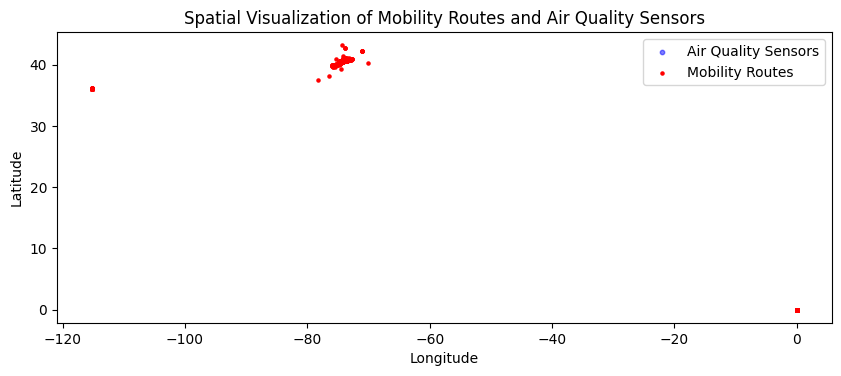

In [150]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

# Convert latitude and longitude to Point geometries
mobility_geometry = [Point(xy) for xy in zip(mobility_df['Pickup_longitude'], mobility_df['Pickup_latitude'])]
mobility_gdf = gpd.GeoDataFrame(mobility_df, geometry=mobility_geometry)

air_geometry = [Point(xy) for xy in zip(air_df['longitude'], air_df['latitude'])]
air_gdf = gpd.GeoDataFrame(air_df, geometry=air_geometry)

# Spatial Join
spatial_join = gpd.sjoin(mobility_gdf, air_gdf, op='intersects', how='inner')

# Spatial Visualization
fig, ax = plt.subplots(figsize=(10, 10))
air_gdf.plot(ax=ax, color='blue', alpha=0.5, markersize=10, label='Air Quality Sensors')
mobility_gdf.plot(ax=ax, color='red', markersize=5, label='Mobility Routes')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Spatial Visualization of Mobility Routes and Air Quality Sensors')
plt.legend()
plt.show()

Insights: Spatial join operation did not find any intersections or overlaps between the mobility routes and the air quality sensor locations.

# Combining Mobility and Air Quality Data




Check if both Datasets have Neighborhood & geohash columns

In [151]:
sjoined_air_quality_original.head()


,SensorID,time,latitude,longitude,bin0,bin1,bin2,bin3,bin4,bin5,...,humidity,pm25,geohash,geometry,index_right,neighborhood,boroughCode,borough,@id,geometryn
0,NYCP2_CS01A,1631277304,40.847672,-73.869316,11,1,1,0,0,0,...,57.3,4.508813,dr72rh,POINT (-73.86932 40.84767),38,Bronx Park,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8223164.965 4991107.997, -8223015.9..."
1,NYCP2_CS01A,1631277308,40.847668,-73.869316,22,4,1,0,0,2,...,57.8,5.462420,dr72rh,POINT (-73.86932 40.84767),38,Bronx Park,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8223164.965 4991107.997, -8223015.9..."
2,NYCP2_CS01A,1631277313,40.847649,-73.869362,40,1,1,0,0,1,...,57.8,5.154881,dr72rh,POINT (-73.86936 40.84765),38,Bronx Park,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8223164.965 4991107.997, -8223015.9..."
3,NYCP2_CS01A,1631277318,40.847649,-73.869362,26,1,0,0,0,0,...,57.6,4.508813,dr72rh,POINT (-73.86936 40.84765),38,Bronx Park,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8223164.965 4991107.997, -8223015.9..."
4,NYCP2_CS01A,1631277323,40.847649,-73.869362,44,4,0,1,0,0,...,57.5,5.539503,dr72rh,POINT (-73.86936 40.84765),38,Bronx Park,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8223164.965 4991107.997, -8223015.9..."


In [152]:
sjoined_trips_original.head()

,id,VendorID,lpep_pickup_datetime,Lpep_dropoff_datetime,Store_and_fwd_flag,RateCodeID,longitude,latitude,Dropoff_longitude,Dropoff_latitude,...,Payment_type,Trip_type,geohash,geometry,index_right,neighborhood,boroughCode,borough,@id,geometryn
1206024,1206024,2,2016-01-27 18:48:44,2016-01-27 19:17:51,N,1,-73.952599,40.811646,-73.977547,40.761353,...,1,1.0,dr72jj,POINT (-73.95260 40.81165),128,Harlem,1,Manhattan,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8230358.427 4987026.661, -8230342.4..."
336223,336223,1,2016-01-08 08:01:22,2016-01-08 08:07:36,N,1,-73.952301,40.810753,-73.940010,40.805561,...,1,1.0,dr72jj,POINT (-73.95230 40.81075),128,Harlem,1,Manhattan,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8230358.427 4987026.661, -8230342.4..."
283567,283567,1,2016-01-06 23:27:14,2016-01-06 23:36:35,N,1,-73.952919,40.808174,-73.937897,40.851986,...,1,1.0,dr72jh,POINT (-73.95292 40.80817),128,Harlem,1,Manhattan,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8230358.427 4987026.661, -8230342.4..."
1151634,1151634,2,2016-01-26 14:48:11,2016-01-26 14:57:17,N,1,-73.954559,40.820984,-73.966400,40.799686,...,2,1.0,dr72jp,POINT (-73.95456 40.82098),128,Harlem,1,Manhattan,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8230358.427 4987026.661, -8230342.4..."
205360,205360,2,2016-01-05 08:05:10,2016-01-05 08:10:35,N,1,-73.948540,40.803387,-73.935326,40.800880,...,2,1.0,dr72jk,POINT (-73.94854 40.80339),128,Harlem,1,Manhattan,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8230358.427 4987026.661, -8230342.4..."


Rename columns

In [153]:
# Rename columns to match
sjoined_air_quality_original.rename(columns={'neighborhood': 'neighborhood_AQ', 'geohash': 'geohash_AQ'}, inplace=True)
sjoined_trips_original.rename(columns={'neighborhood': 'neighborhood_mobility', 'geohash': 'geohash_mobility'}, inplace=True)

# Verify column names after renaming
print(sjoined_air_quality_original.columns)
print(sjoined_trips_original.columns)
print("Length of sjoined_air_quality_original is ",len(sjoined_air_quality_original) )
print ("Length of sjoined_trips_original is ",len(sjoined_trips_original) )


Index(['SensorID', 'time', 'latitude', 'longitude', 'bin0', 'bin1', 'bin2',
       'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8', 'bin9', 'bin10',
       'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'bin16', 'bin17', 'bin18',
       'bin19', 'bin20', 'bin21', 'bin22', 'bin23', 'temperature', 'humidity',
       'pm25', 'geohash_AQ', 'geometry', 'index_right', 'neighborhood_AQ',
       'boroughCode', 'borough', '@id', 'geometryn'],
      dtype='object')
Index(['id', 'VendorID', 'lpep_pickup_datetime', 'Lpep_dropoff_datetime',
       'Store_and_fwd_flag', 'RateCodeID', 'longitude', 'latitude',
       'Dropoff_longitude', 'Dropoff_latitude', 'Passenger_count',
       'Trip_distance', 'Fare_amount', 'Extra', 'MTA_tax', 'Tip_amount',
       'Tolls_amount', 'Ehail_fee', 'improvement_surcharge', 'Total_amount',
       'Payment_type', 'Trip_type', 'geohash_mobility', 'geometry',
       'index_right', 'neighborhood_mobility', 'boroughCode', 'borough', '@id',
       'geometryn'],
      dtype='ob

check if data type of neighborhoods and geohash is the same in each dataset

In [154]:
# Get the data types of 'neighborhood_AQ' and 'geohash_AQ' columns
neighborhood_AQ_dtype = sjoined_air_quality_original['neighborhood_AQ'].dtype
geohash_AQ_dtype = sjoined_air_quality_original['geohash_AQ'].dtype
# Print the data types
print("Data type of 'neighborhood_AQ':", neighborhood_AQ_dtype)
print("Data type of 'geohash_AQ':", geohash_AQ_dtype)

# Get the data types of 'neighborhood_mobility' and 'geohash_mobility' columns
neighborhood_mobility_dtype = sjoined_trips_original['neighborhood_mobility'].dtype
geohash_mobility_dtype = sjoined_trips_original['geohash_mobility'].dtype
# Print the data types
print("Data type of 'neighborhood_mobility':", neighborhood_mobility_dtype)
print("Data type of 'geohash_mobility':", geohash_mobility_dtype)

Data type of 'neighborhood_AQ': object
Data type of 'geohash_AQ': object
Data type of 'neighborhood_mobility': object
Data type of 'geohash_mobility': object


perfome merge in increments to be memory effecient

In [155]:
#Sample 50,000 rows from sjoined_air_quality_original
sample_air_quality = sjoined_air_quality_original.sample(n=50000, random_state=42)

# Sample 50,000 rows from sjoined_trips_original
sample_trips = sjoined_trips_original.sample(n=50000, random_state=42)

In [156]:
# Define chunk size for incremental merge
chunk_size = 10000

# Split the dataframes into chunks
chunks_air_quality = [sample_air_quality[i:i + chunk_size] for i in range(0, len(sample_air_quality), chunk_size)]
chunks_mobility = [sample_trips[i:i + chunk_size] for i in range(0, len(sample_trips), chunk_size)]

# Initialize an empty list to store merged chunks
merged_chunks = []

# Perform incremental merge with outer join
for chunk_air_quality, chunk_mobility in zip(chunks_air_quality, chunks_mobility):
    merged_chunk = pd.merge(chunk_air_quality, chunk_mobility,
                            left_on=['neighborhood_AQ', 'geohash_AQ'],
                            right_on=['neighborhood_mobility', 'geohash_mobility'],
                            how='inner')  # Changed to outer join
    merged_chunks.append(merged_chunk)

# Concatenate the merged chunks into a single dataframe
merged_data = pd.concat(merged_chunks)
print(merged_data.head())


      SensorID        time  latitude_x  longitude_x  bin0  bin1  bin2  bin3  \
0  NYCP2_CS01A  1632426780   40.844555   -73.871017    40    24     8    12   
1  NYCP2_CS01A  1632426780   40.844555   -73.871017    40    24     8    12   
2  NYCP2_CS01A  1632426780   40.844555   -73.871017    40    24     8    12   
3  NYCP2_CS01A  1632807194   40.844788   -73.870979    62     8     3     0   
4  NYCP2_CS01A  1632807194   40.844788   -73.870979    62     8     3     0   

   bin4  bin5  ...  Payment_type  Trip_type  geohash_mobility  \
0     7     3  ...             2        2.0            dr72r5   
1     7     3  ...             2        1.0            dr72r5   
2     7     3  ...             1        1.0            dr72r5   
3     0     1  ...             2        2.0            dr72r5   
4     0     1  ...             2        1.0            dr72r5   

                   geometry_y  index_right_y  neighborhood_mobility  \
0  POINT (-73.86710 40.84302)            292               Van 

In [157]:
print(merged_data.columns)

Index(['SensorID', 'time', 'latitude_x', 'longitude_x', 'bin0', 'bin1', 'bin2',
       'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8', 'bin9', 'bin10',
       'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'bin16', 'bin17', 'bin18',
       'bin19', 'bin20', 'bin21', 'bin22', 'bin23', 'temperature', 'humidity',
       'pm25', 'geohash_AQ', 'geometry_x', 'index_right_x', 'neighborhood_AQ',
       'boroughCode_x', 'borough_x', '@id_x', 'geometryn_x', 'id', 'VendorID',
       'lpep_pickup_datetime', 'Lpep_dropoff_datetime', 'Store_and_fwd_flag',
       'RateCodeID', 'longitude_y', 'latitude_y', 'Dropoff_longitude',
       'Dropoff_latitude', 'Passenger_count', 'Trip_distance', 'Fare_amount',
       'Extra', 'MTA_tax', 'Tip_amount', 'Tolls_amount', 'Ehail_fee',
       'improvement_surcharge', 'Total_amount', 'Payment_type', 'Trip_type',
       'geohash_mobility', 'geometry_y', 'index_right_y',
       'neighborhood_mobility', 'boroughCode_y', 'borough_y', '@id_y',
       'geometryn_y'],
      

In [158]:
merged_data.head()

,SensorID,time,latitude_x,longitude_x,bin0,bin1,bin2,bin3,bin4,bin5,...,Payment_type,Trip_type,geohash_mobility,geometry_y,index_right_y,neighborhood_mobility,boroughCode_y,borough_y,@id_y,geometryn_y
0,NYCP2_CS01A,1632426780,40.844555,-73.871017,40,24,8,12,7,3,...,2,2.0,dr72r5,POINT (-73.86710 40.84302),292,Van Nest,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8222628.313 4988949.519, -8222962.1..."
1,NYCP2_CS01A,1632426780,40.844555,-73.871017,40,24,8,12,7,3,...,2,1.0,dr72r5,POINT (-73.86959 40.84290),292,Van Nest,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8222628.313 4988949.519, -8222962.1..."
2,NYCP2_CS01A,1632426780,40.844555,-73.871017,40,24,8,12,7,3,...,1,1.0,dr72r5,POINT (-73.87187 40.84207),292,Van Nest,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8222628.313 4988949.519, -8222962.1..."
3,NYCP2_CS01A,1632807194,40.844788,-73.870979,62,8,3,0,0,1,...,2,2.0,dr72r5,POINT (-73.86710 40.84302),292,Van Nest,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8222628.313 4988949.519, -8222962.1..."
4,NYCP2_CS01A,1632807194,40.844788,-73.870979,62,8,3,0,0,1,...,2,1.0,dr72r5,POINT (-73.86959 40.84290),292,Van Nest,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8222628.313 4988949.519, -8222962.1..."


In [159]:
print(merged_data[['longitude_y', 'latitude_y', 'longitude_x', 'latitude_x',
                   'geohash_AQ', 'neighborhood_AQ', 'neighborhood_mobility',
                   'geohash_mobility']].head())


   longitude_y  latitude_y  longitude_x  latitude_x geohash_AQ  \
0   -73.867104   40.843021   -73.871017   40.844555     dr72r5   
1   -73.869591   40.842899   -73.871017   40.844555     dr72r5   
2   -73.871872   40.842072   -73.871017   40.844555     dr72r5   
3   -73.867104   40.843021   -73.870979   40.844788     dr72r5   
4   -73.869591   40.842899   -73.870979   40.844788     dr72r5   

  neighborhood_AQ neighborhood_mobility geohash_mobility  
0        Van Nest              Van Nest           dr72r5  
1        Van Nest              Van Nest           dr72r5  
2        Van Nest              Van Nest           dr72r5  
3        Van Nest              Van Nest           dr72r5  
4        Van Nest              Van Nest           dr72r5  


In [160]:
len(merged_data)

130966

In [161]:
from shapely.geometry import Point
# Create a geometry column containing Point objects
geometry = [Point(xy) for xy in zip(merged_data.longitude_x, merged_data.latitude_x)]

# Create a GeoDataFrame from merged_data and the geometry column
merged_gdf = gpd.GeoDataFrame(merged_data, geometry=geometry)

# Set the coordinate reference system (CRS) if needed (e.g., WGS 84)
merged_gdf.crs = 'EPSG:4326'  # WGS 84

# Print the head of the GeoDataFrame to verify
print(merged_gdf.head())

      SensorID        time  latitude_x  longitude_x  bin0  bin1  bin2  bin3  \
0  NYCP2_CS01A  1632426780   40.844555   -73.871017    40    24     8    12   
1  NYCP2_CS01A  1632426780   40.844555   -73.871017    40    24     8    12   
2  NYCP2_CS01A  1632426780   40.844555   -73.871017    40    24     8    12   
3  NYCP2_CS01A  1632807194   40.844788   -73.870979    62     8     3     0   
4  NYCP2_CS01A  1632807194   40.844788   -73.870979    62     8     3     0   

   bin4  bin5  ...  Trip_type  geohash_mobility                  geometry_y  \
0     7     3  ...        2.0            dr72r5  POINT (-73.86710 40.84302)   
1     7     3  ...        1.0            dr72r5  POINT (-73.86959 40.84290)   
2     7     3  ...        1.0            dr72r5  POINT (-73.87187 40.84207)   
3     0     1  ...        2.0            dr72r5  POINT (-73.86710 40.84302)   
4     0     1  ...        1.0            dr72r5  POINT (-73.86959 40.84290)   

   index_right_y  neighborhood_mobility  boroughCo

The merge is performed on two criteria:
Neighborhood: The 'neighborhood_AQ' column from sjoined_air_quality_original is matched with the 'neighborhood_mobility' column from sjoined_trips_original.
Geohash: The 'geohash_AQ' column from sjoined_air_quality_original is matched with the 'geohash_mobility' column from sjoined_trips_original.
Only rows where both neighborhood and geohash match between the datasets are included in the merged dataset.

# Geo-visualization of the data: Generating heatmaps
Geovisualization is the process of using visual representations, such as maps, charts, and graphs, to explore, analyze, and communicate geographic information and spatial relationships.

In [ ]:
# Import libraries
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns


### Kernel Density Estimation Heatmap of Merged Data
This code generates a kernel density estimation heatmap of the merged geographical data, illustrating the distribution of latitude and longitude points.

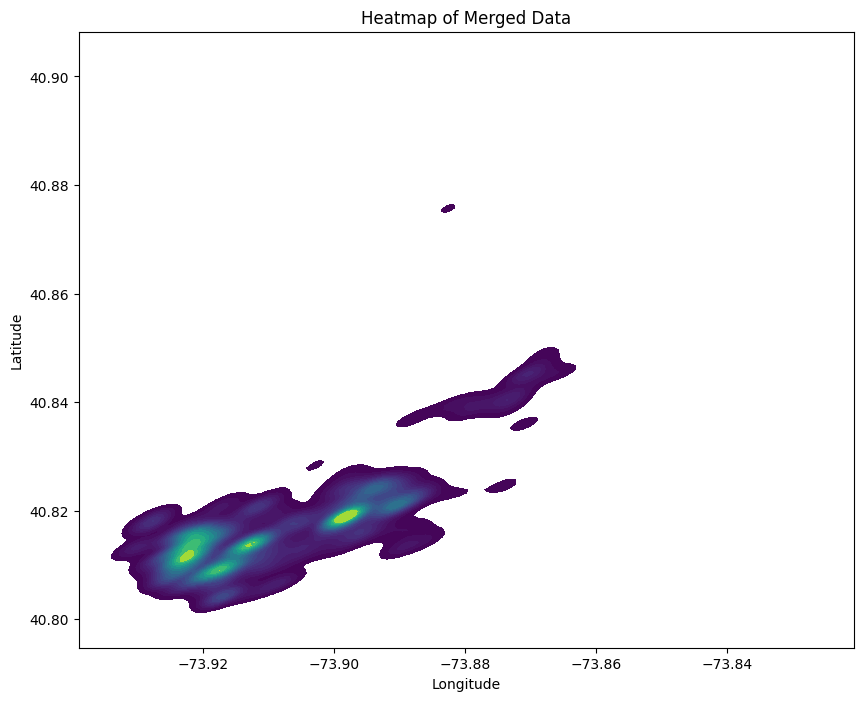

In [ ]:
plt.figure(figsize=(10, 8))
sns.kdeplot(data=merged_gdf, x='longitude_x', y='latitude_x', fill=True, cmap='viridis', levels=20)
plt.title('Heatmap of Merged Data')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

Insights:

Spatial Clusters:
The plot reveals two distinct clusters of data points.
The larger cluster on the left side indicates a region with high data density. Its elongated shape suggests a specific area of interest.
The smaller cluster positioned above and to the right of the larger one represents a localized concentration of data points.

Longitude and Latitude Ranges:
The longitude values span approximately from -73.92 to -73.84.
The latitude values cover a range of approximately 40.76 to 40.90.
Understanding these ranges helps contextualize the geographical spread of the data.

Intensity Gradient:
The color gradient transitions from dark purple (low density) to bright green/yellow (high density).
Darker areas indicate regions with more data points, while lighter areas represent sparser regions.
The intensity of color provides insights into the density variation across the plot.

Geographical Patterns:
By analyzing the plot, we can infer geographical patterns:
The elongated shape of the larger cluster suggests a specific corridor along the longitude axis.
The smaller cluster may correspond to a localized hotspot or a distinct geographical feature.
Investigating the specific locations represented by these clusters could reveal valuable context about the dataset.

### Heatmap of Aggregated Air Quality Metrics
This code uses the Folium library to generate a base map centered at the mean latitude and longitude of the dataset's spatial coordinates, and overlays a HeatMap layer representing the aggregated air quality metrics (sum of all bins) at each location.

In [ ]:
import folium
from folium.plugins import HeatMap

# Assuming merged_data is your combined DataFrame

# Aggregate air quality metrics (e.g., sum of all bins)
merged_data['air_quality'] = merged_data[['bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5']].sum(axis=1)

# Generate base map
base_map = folium.Map(location=[merged_data['latitude_x'].mean(), merged_data['longitude_x'].mean()], zoom_start=10)

# Create HeatMap layer
HeatMap(data=merged_data[['latitude_x', 'longitude_x', 'air_quality']], radius=10, max_zoom=13).add_to(base_map)

# Display the map
base_map

Insights:

Manhattan Concentration:
The heatmap shows a significant concentration of aggregated air quality metrics around the northern part of Manhattan. This area likely experiences higher pollution levels due to factors such as traffic, industrial activity, and population density.

Bronx Extension:
The heatmap extension into the Bronx remains visible, indicating that this borough also faces air quality challenges. Urban areas with dense populations tend to exhibit higher aggregated metrics.

Urban Density Influence:
Areas with dense populations (e.g., Manhattan, Bronx) exhibit higher aggregated metrics.
Despite being densely populated, some urban regions still show relatively low air quality.

### Temperature Distribution Heatmap with Sampled Geographical Data
This code generates a HeatMap on a Folium map using a subset of sampled geographical data, displaying temperature variations across latitude and longitude coordinates.

In [ ]:
import pandas as pd
import folium
from folium.plugins import HeatMap

data = merged_data[['latitude_y', 'longitude_y', 'temperature']]

# Check population size and sample size
population_size = len(data)
sample_size = 100000

if sample_size > population_size:
    print("Sample size is larger than the population size. Adjusting sample size.")
    sample_size = min(sample_size, population_size)

# Sample a subset of data
sampled_data = data.sample(n=sample_size, replace=False)  # Sample without replacement

# Generate base map
base_map_merged = folium.Map(location=[sampled_data['latitude_y'].mean(), sampled_data['longitude_y'].mean()], zoom_start=10)

# Create HeatMap layer
HeatMap(data=sampled_data[['latitude_y', 'longitude_y', 'temperature']].values.tolist(),
        radius=8, max_zoom=13).add_to(base_map_merged)

# Display the map
base_map_merged


Insights:

Central Bronx Hotspot:
The heatmap reveals a significant concentration of warmer temperatures in the central part of The Bronx. This area likely experiences higher temperatures due to urban heat island effects, infrastructure, and population density.

Cross-State Patterns:
The heatmap extends into New Jersey, covering locations like Union City and North Bergen.
These areas share temperature patterns with New York City, likely influenced by similar environmental factors.

Water Bodies and Cooler Areas:
Water bodies, such as the Hudson River, appear as cooler areas on the heatmap.
The temperature variations near water suggest that proximity to rivers and other water features can mitigate heat intensity.

### PM2.5 Concentration Heatmap with Sampled Geographical Data
This code samples a subset of geographical data points from a DataFrame, creates a base map centered at the mean latitude and longitude of the sampled points, and overlays a HeatMap layer representing PM2.5 concentrations, displaying the map using Folium.

In [ ]:
data = merged_gdf[['latitude_x', 'longitude_x', 'pm25']]

# Check population size and sample size
population_size = len(data)
sample_size = len(merged_gdf)

if sample_size > population_size:
    print("Sample size is larger than the population size. Adjusting sample size.")
    sample_size = min(sample_size, population_size)

# Sample a subset of data
sampled_data = data.sample(n=sample_size, replace=False)  # Sample without replacement

# Generate base map
base_map_merged = folium.Map(location=[sampled_data['latitude_x'].mean(), sampled_data['longitude_x'].mean()], zoom_start=10)

# Create HeatMap layer
HeatMap(data=sampled_data[['latitude_x', 'longitude_x', 'pm25']].values.tolist(),
        radius=8, max_zoom=13).add_to(base_map_merged)

# Display the map
base_map_merged

Central Bronx Hotspot:
The heatmap indicates a significant concentration of PM2.5 particles in the central part of The Bronx.
This area likely experiences higher pollution levels due to factors such as traffic, industrial emissions, and population density.

Cross-State Patterns:
The heatmap extends into New Jersey, covering locations like Union City and North Bergen.
These areas share PM2.5 concentration patterns with New York City, likely influenced by similar environmental factors.

Urban Density Influence:
Areas with dense populations (e.g., Manhattan, Bronx) exhibit higher PM2.5 concentrations.
Despite being densely populated, some urban regions still show relatively low PM2.5 levels.
Understanding the interplay between population density, emissions, and air quality is crucial for targeted interventions.

Insight 1: Spatial Distribution Patterns
Across all four heatmaps, we observe spatial distribution patterns indicating localized clusters and broader trends.
In the Kernel Density Estimation Heatmap and the PM2.5 Concentration Heatmap, distinct clusters are visible, suggesting areas with higher data density and pollution levels, respectively.
These spatial patterns provide valuable insights into the geographical distribution of various metrics, enabling targeted analysis and interventions.

Insight 2: Urbanization and Environmental Impact
The heatmaps consistently highlight urban areas, such as Manhattan and the Bronx, as regions with higher concentrations of data points, air quality metrics, and temperature variations.
Urbanization and population density likely contribute to increased pollution levels and higher temperatures, as observed in the aggregated air quality and temperature distribution heatmaps.
Understanding the environmental impact of urbanization is crucial for urban planning, public health initiatives, and climate resilience strategies.

Insight 3: Cross-State Environmental Trends
The extension of heatmap patterns into neighboring states, such as New Jersey, indicates shared environmental trends and challenges across state boundaries.
This cross-state consistency suggests common factors influencing air quality, temperature variations, and other environmental metrics in the region.
Collaborative efforts and coordinated policies may be necessary to address these shared environmental concerns effectively.

# Generating graphs to study the autocorrelation in the data: Histograms

### Histograms of Temperature, Humidity, and PM2.5

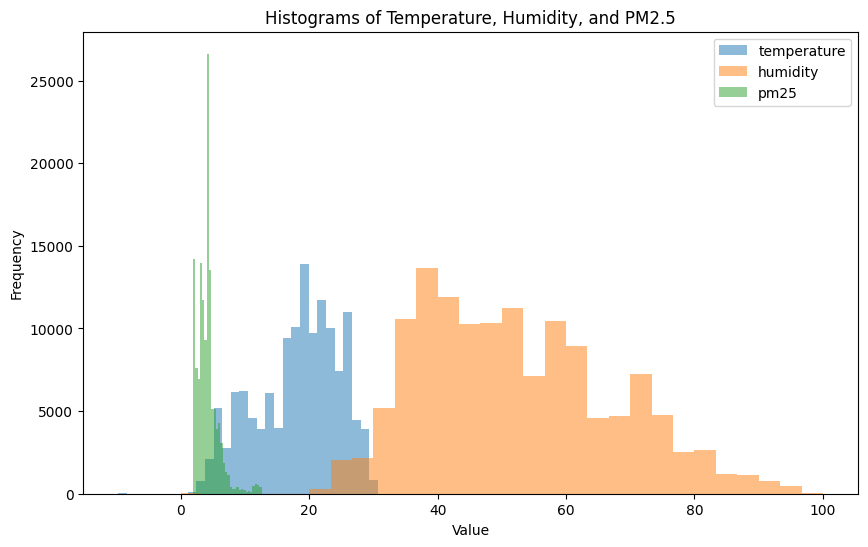

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select relevant columns for study
selected_columns = ['temperature', 'humidity', 'pm25']

# Plot histograms using matplotlib
plt.figure(figsize=(10, 6))
for column in selected_columns:
    plt.hist(merged_gdf[column], bins=30, alpha=0.5, label=column)
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.title('Histograms of Temperature, Humidity, and PM2.5')
plt.legend()
plt.show()

**Terminologies: **
(1) PM2.5 denotes particulate matter with a diameter of 2.5 micrometers or less. These minute particles consist of a mix of materials including dust, dirt, soot, smoke, and tiny liquid droplets. As a prevalent air pollutant, PM2.5 poses health risks when breathed in, as it can infiltrate the respiratory system deeply and may even enter the bloodstream.

(2) Autocorrelation, also known as serial correlation, is a statistical concept that measures the degree of correlation between a variable and its lagged values over time. In simpler terms, it assesses the extent to which a variable's current value is correlated with its past values.

**Insights: **
(1) The green bars in the histogram represent PM2.5 levels. Most of the data points cluster around the lower end of the scale (0-10). This suggests that there are frequent occurrences of low PM2.5 levels in the air. However, it’s positive to see that the majority of measurements fall within this range, as higher PM2.5 levels can be harmful to health.

(2) The blue bars correspond to humidity levels. The distribution is more varied compared to PM2.5. However, there’s a noticeable peak around the 40-50 humidity value range. This indicates that humidity values in this range are common in the environment.

(3) The orange bars represent temperature. Unlike PM2.5 and humidity, temperature data is spread across a wider range. There’s a significant frequency of measurements between 60 and 80. This suggests that the environment experiences a variety of temperatures, with a concentration in the warmer range.


### Histograms of Selected Numerical Columns
Visualizing the distribution of selected numerical variables through histograms in a subplot grid.

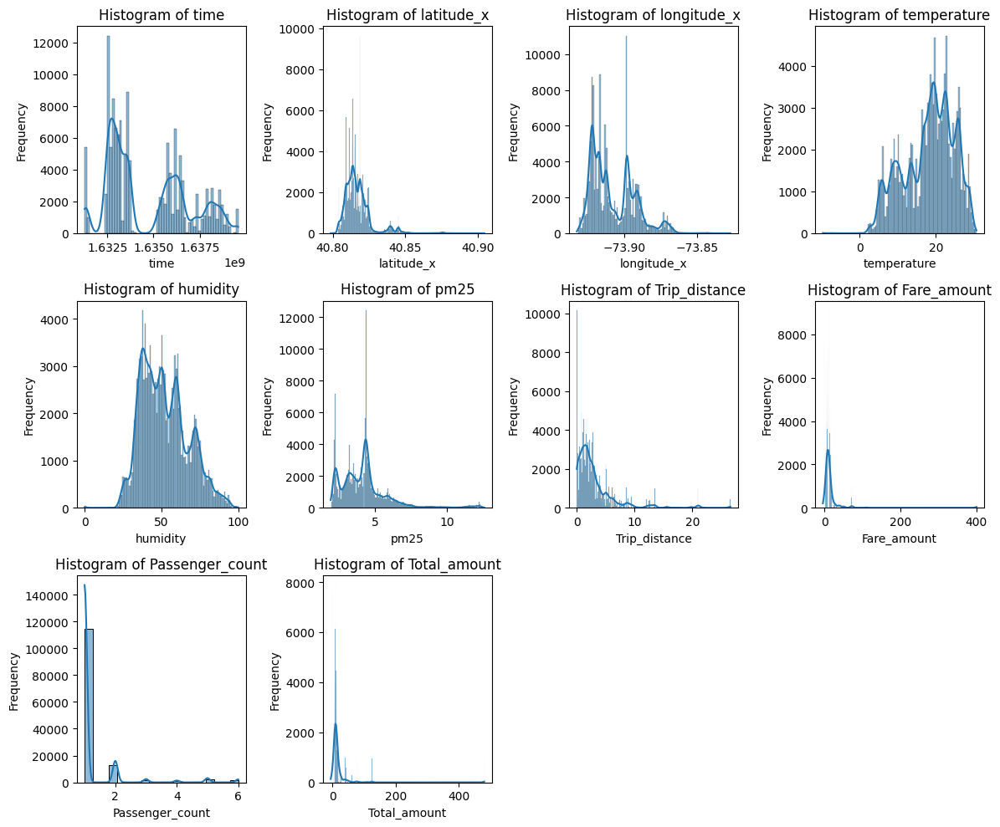

In [ ]:
# Plot histograms for selected numerical columns
selected_numeric_columns = ['time', 'latitude_x', 'longitude_x', 'temperature', 'humidity', 'pm25',
                            'Trip_distance', 'Fare_amount', 'Passenger_count', 'Total_amount']

plt.figure(figsize=(12, 10))
for i, column in enumerate(selected_numeric_columns, 1):
    plt.subplot(3, 4, i)
    sns.histplot(data=merged_data, x=column, kde=True)
    plt.title(f'Histogram of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
plt.tight_layout()
plt.show()

Insights:

(1) Time Histogram: The histogram of time shows multiple peaks, indicating specific time intervals with higher frequencies. Autocorrelation analysis can help determine if there are daily or weekly patterns in mobility or air quality data. Next, we will calculate autocorrelation coefficients for time intervals (lags) to assess temporal dependencies.

(2) Latitude and Longitude Histograms: The sharp peaks in the histograms of latitude and longitude suggest specific geographical locations with frequent occurrences.

(3) Temperature Histogram: The wide distribution of temperature values indicates variations over time. We will explore autocorrelation in temperature data to identify seasonal trends. we will calculate lagged correlations to assess whether today's temperature relates to past days' temperatures.

(4) Humidity Histogram: The normal distribution centered around 50% humidity suggests consistent humidity levels. Autocorrelation analysis can reveal cyclic patterns (e.g., daily or weekly) in humidity data. We will look for significant correlations at specific lags.

(5) PM2.5 Histogram: The right-skewed distribution indicates higher frequencies at lower PM2.5 levels. We will investigate autocorrelation to understand if today's PM2.5 level depends on previous days' levels. We will calculate ACF values for different time lags (e.g., 1 day, 7 days).

(6) Trip Distance and Fare Amount Histograms: Both histograms are right-skewed, suggesting that shorter trips and lower fares are more common. We will explore autocorrelation in trip distance and fare amount data to detect any recurring patterns.

(7) Passenger Count Histogram: The sharp peak at 1 or 2 passengers indicates common ride scenarios. We will assess autocorrelation to understand if passenger count follows specific daily or weekly cycles.

(8) Total Amount Histogram: Similar to fare amount, the right-skewed distribution suggests most total amounts are on the lower side. We will investigate autocorrelation to identify any consistent trends in total amounts.

### Autocorrelation Analysis of Time Intervals for Mobility or Air Quality Data

In [163]:
# Calculate autocorrelation for different lags
lags = range(1, 11)  # Example: Calculate autocorrelation up to lag 10
autocorrelation_results = []

for lag in lags:
    # Shift the variable by the lag
    shifted_variable = merged_data['time'].shift(lag)

    # Calculate Pearson correlation coefficient
    correlation_coefficient = merged_data['time'].corr(shifted_variable)

    # Store the result
    autocorrelation_results.append(correlation_coefficient)

# Create a DataFrame to store results
autocorrelation_df = pd.DataFrame({'Lag': lags, 'Autocorrelation': autocorrelation_results})

# Print or visualize the results
print(autocorrelation_df)

   Lag  Autocorrelation
0    1         0.775024
1    2         0.580305
2    3         0.438866
3    4         0.335567
4    5         0.261239
5    6         0.212451
6    7         0.184393
7    8         0.165826
8    9         0.157513
9   10         0.151167


Based on the autocorrelation coefficients calculated for time intervals (lags), we observe the following findings:

1. **Decreasing Autocorrelation with Increasing Lag**: As the lag increases, the autocorrelation coefficients generally decrease. This suggests that the correlation between the time intervals diminishes as we move further away from the original time point.

2. **Significant Positive Autocorrelation**: The autocorrelation coefficients are consistently positive across the lags, indicating a strong positive correlation between consecutive time intervals. This suggests that there is a persistent pattern or trend in the data, where observations at one time point are positively correlated with observations at subsequent time points.

3. **Strongest Autocorrelation at Lag 1**: The highest autocorrelation coefficient is observed at lag 1, with a value of approximately 0.775. This indicates that there is a strong positive correlation between consecutive time intervals, implying that observations at a particular time are highly correlated with observations at the immediately preceding time point.

4. **Interpretation for Temporal Patterns**: The decreasing autocorrelation coefficients suggest that while there are strong temporal dependencies between consecutive time intervals (e.g., daily or weekly patterns), the strength of these dependencies gradually diminishes as the time lag increases. This information can be valuable for understanding and modeling temporal patterns in mobility or air quality data, potentially indicating daily or weekly trends in the dataset.

### Autocorrelation Analysis of Temperature Data for Seasonal Trends

In [164]:
# Calculate autocorrelation for different lags
lags = range(1, 11)  # Example: Calculate autocorrelation up to lag 10
autocorrelation_results = []

for lag in lags:
    # Shift the temperature variable by the lag
    shifted_temperature = merged_data['temperature'].shift(lag)

    # Calculate Pearson correlation coefficient
    correlation_coefficient = merged_data['temperature'].corr(shifted_temperature)

    # Store the result
    autocorrelation_results.append(correlation_coefficient)

# Create a DataFrame to store results
autocorrelation_df = pd.DataFrame({'Lag': lags, 'Autocorrelation': autocorrelation_results})

# Print or visualize the results
print(autocorrelation_df)

   Lag  Autocorrelation
0    1         0.776818
1    2         0.587862
2    3         0.450397
3    4         0.352562
4    5         0.281448
5    6         0.232835
6    7         0.202451
7    8         0.180401
8    9         0.172013
9   10         0.164274


Based on the calculated autocorrelation coefficients for temperature data at different lags, the following findings can be observed:

1. **Decreasing Autocorrelation with Increasing Lag**: As the lag increases, the autocorrelation coefficients generally decrease. This indicates that the correlation between temperature values diminishes as we look further back in time.

2. **Positive Autocorrelation**: The autocorrelation coefficients are consistently positive across the lags, suggesting a positive correlation between temperature values at different time points. This implies that there is a tendency for temperature values to exhibit similar patterns over time.

3. **Strongest Autocorrelation at Lag 1**: The highest autocorrelation coefficient is observed at lag 1, with a value of approximately 0.777. This indicates a strong positive correlation between today's temperature and the temperature of the previous day.

4. **Interpretation for Seasonal Trends**: The decreasing autocorrelation coefficients suggest that while there is a strong correlation between temperature values at adjacent time points, the strength of this correlation decreases as we consider temperature values further apart in time. This analysis helps identify seasonal trends in temperature data, indicating how today's temperature relates to past days' temperatures.

### Autocorrelation Analysis of Humidity Data for Cyclic Patterns

In [165]:
# Calculate autocorrelation for different lags
lags = range(1, 11)  # Example: Calculate autocorrelation up to lag 10
autocorrelation_results = []

for lag in lags:
    # Shift the humidity variable by the lag
    shifted_humidity = merged_data['humidity'].shift(lag)

    # Calculate Pearson correlation coefficient
    correlation_coefficient = merged_data['humidity'].corr(shifted_humidity)

    # Store the result
    autocorrelation_results.append(correlation_coefficient)

# Create a DataFrame to store results
autocorrelation_df = pd.DataFrame({'Lag': lags, 'Autocorrelation': autocorrelation_results})

# Print or visualize the results
print(autocorrelation_df)

   Lag  Autocorrelation
0    1         0.771870
1    2         0.583428
2    3         0.446373
3    4         0.351098
4    5         0.282389
5    6         0.232017
6    7         0.193220
7    8         0.162008
8    9         0.146181
9   10         0.132583


Based on the calculated autocorrelation coefficients for humidity data at different lags, the following findings can be observed:

1. **Decreasing Autocorrelation with Increasing Lag**: As the lag increases, the autocorrelation coefficients generally decrease. This suggests that the correlation between humidity values diminishes as we look further back in time.

2. **Positive Autocorrelation**: The autocorrelation coefficients are consistently positive across the lags, indicating a positive correlation between humidity values at different time points. This implies that there is a tendency for humidity levels to exhibit similar patterns over time.

3. **Strongest Autocorrelation at Lag 1**: The highest autocorrelation coefficient is observed at lag 1, with a value of approximately 0.772. This indicates a strong positive correlation between humidity levels at the current time and those at the previous time point.

4. **Interpretation for Cyclic Patterns**: The decreasing autocorrelation coefficients suggest that while there is a strong correlation between humidity values at adjacent time points, the strength of this correlation decreases as we consider humidity values further apart in time. This analysis helps identify cyclic patterns in humidity data, such as daily or weekly fluctuations, and reveals how humidity levels at specific time points relate to those at earlier time points.

### Autocorrelation Analysis of PM2.5 Data for Temporal Dependencies

In [166]:
# Calculate autocorrelation for different lags
lags = [1, 7]  # Example: Calculate autocorrelation for lag 1 day and 7 days
autocorrelation_results = []

for lag in lags:
    # Shift the PM2.5 variable by the lag
    shifted_pm25 = merged_data['pm25'].shift(lag)

    # Calculate Pearson correlation coefficient
    correlation_coefficient = merged_data['pm25'].corr(shifted_pm25)

    # Store the result
    autocorrelation_results.append(correlation_coefficient)

# Create a DataFrame to store results
autocorrelation_df = pd.DataFrame({'Lag': lags, 'Autocorrelation': autocorrelation_results})

# Print or visualize the results
print(autocorrelation_df)

   Lag  Autocorrelation
0    1         0.761829
1    7         0.163762


Based on the calculated autocorrelation coefficients for PM2.5 data at different time lags, the findings are as follows:

1. **Autocorrelation at Lag 1**: The autocorrelation coefficient for a lag of 1 day is approximately 0.762. This indicates a moderate positive correlation between today's PM2.5 level and the PM2.5 level of the previous day. It suggests that there is some degree of persistence in PM2.5 levels from one day to the next.

2. **Autocorrelation at Lag 7**: The autocorrelation coefficient for a lag of 7 days is approximately 0.164. This value is much lower compared to the autocorrelation at lag 1, indicating a weaker correlation between PM2.5 levels separated by a week. It suggests that the correlation between today's PM2.5 level and the PM2.5 level 7 days ago is less pronounced, implying less persistence in PM2.5 levels over longer time intervals.

I

### Autocorrelation Analysis of Trip Distance and Fare Amount Data for Recurring Patterns

In [167]:
# Calculate autocorrelation for trip distance
trip_distance_autocorr = merged_data['Trip_distance'].autocorr()

# Calculate autocorrelation for fare amount
fare_amount_autocorr = merged_data['Fare_amount'].autocorr()

# Print or visualize the results
print("Autocorrelation for Trip Distance:", trip_distance_autocorr)
print("Autocorrelation for Fare Amount:", fare_amount_autocorr)

Autocorrelation for Trip Distance: 0.15713110641188927
Autocorrelation for Fare Amount: 0.09704861346590431


Based on the calculated autocorrelation coefficients for trip distance and fare amount data, the findings are as follows:

1. **Autocorrelation for Trip Distance**: The autocorrelation coefficient for trip distance is approximately 0.157. This indicates a weak positive correlation between the trip distances at adjacent time points. It suggests that there is some degree of persistence in trip distances from one trip to the next, but the correlation is not very strong.

2. **Autocorrelation for Fare Amount**: The autocorrelation coefficient for fare amount is approximately 0.097. Similar to trip distance, this value indicates a weak positive correlation between the fare amounts at adjacent time points. It suggests that there is some persistence in fare amounts from one trip to the next, but the correlation is relatively low.

### Autocorrelation Analysis of Passenger Count Data for Daily or Weekly Cycles

In [168]:
# Calculate autocorrelation for passenger count
passenger_count_autocorr = merged_data['Passenger_count'].autocorr()

# Print or visualize the results
print("Autocorrelation for Passenger Count:", passenger_count_autocorr)

Autocorrelation for Passenger Count: 0.06350868835389588


Based on the calculated autocorrelation coefficient for passenger count data, the finding is as follows:

**Autocorrelation for Passenger Count**: The autocorrelation coefficient for passenger count is approximately 0.064. This value indicates a very weak positive correlation between passenger counts at adjacent time points. It suggests that there is minimal persistence in passenger counts from one time point to the next, implying that passenger count data does not exhibit strong cyclic patterns at daily or weekly intervals.

### Autocorrelation Analysis of Total Amount Data for Consistent Trends

In [169]:
# Calculate autocorrelation for total amount
total_amount_autocorr = merged_data['Total_amount'].autocorr()

# Print or visualize the results
print("Autocorrelation for Total Amount:", total_amount_autocorr)

Autocorrelation for Total Amount: 0.14159940772288163


Based on the calculated autocorrelation coefficient for total amount data, the finding is as follows:

**Autocorrelation for Total Amount**: The autocorrelation coefficient for total amount is approximately 0.142. This value indicates a weak positive correlation between total amounts at adjacent time points. It suggests that there is some degree of persistence in total amounts from one time point to the next, implying that total amounts may exhibit some level of consistency or trend over time.

# Scatter plot

Trip Duration vs PM2.5 Value

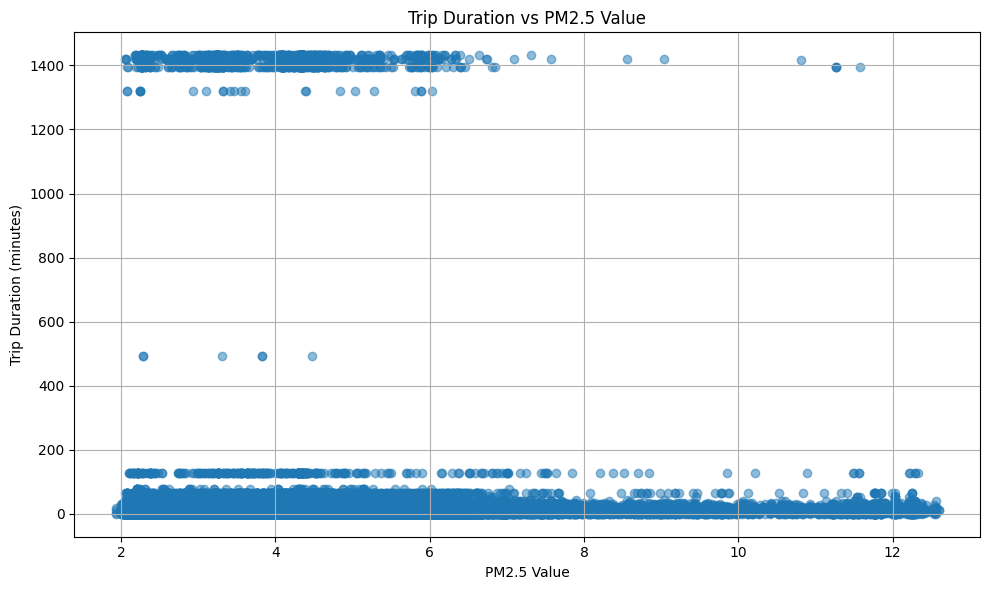

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

# Convert 'lpep_pickup_datetime' and 'Lpep_dropoff_datetime' columns to datetime format
merged_gdf['lpep_pickup_datetime'] = pd.to_datetime(merged_gdf['lpep_pickup_datetime'])
merged_gdf['Lpep_dropoff_datetime'] = pd.to_datetime(merged_gdf['Lpep_dropoff_datetime'])

# Calculate trip duration in minutes
merged_gdf['duration'] = (merged_gdf['Lpep_dropoff_datetime'] - merged_gdf['lpep_pickup_datetime']).dt.total_seconds() / 60.0

# Plotting trip duration versus PM2.5 values
fig, ax = plt.subplots(figsize=(10, 6))
ax.scatter(merged_gdf['pm25'], merged_gdf['duration'], alpha=0.5)  # Scatter plot with transparency
plt.xlabel('PM2.5 Value')
plt.ylabel('Trip Duration (minutes)')
plt.title('Trip Duration vs PM2.5 Value')
plt.grid(True)
plt.tight_layout()
plt.show()



#Spaghetti plot

PM2.5 Variation Over Time (Spaghetti Plot)

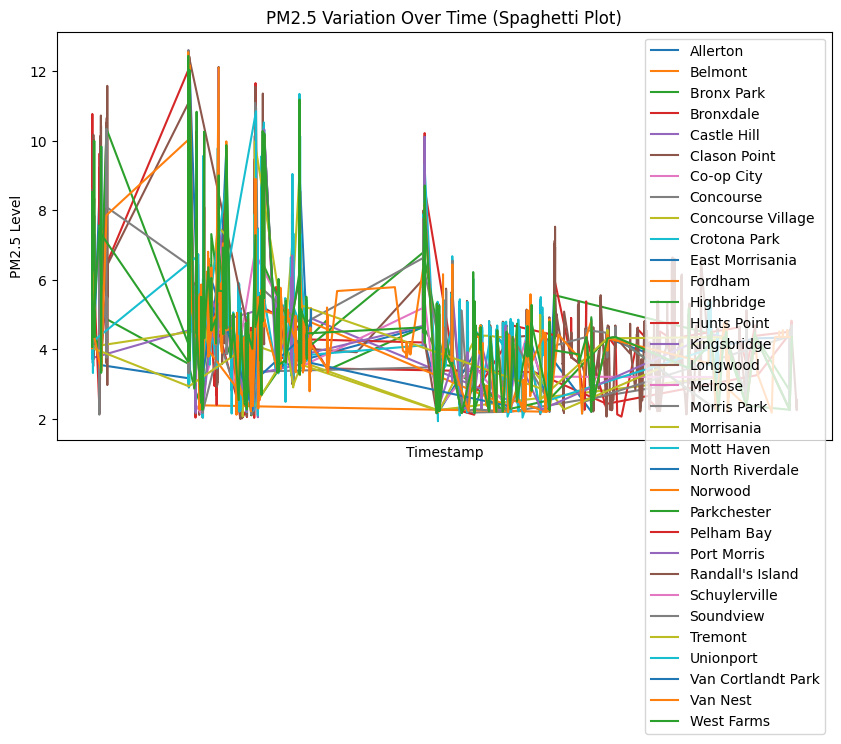

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

# Convert 'time' column to datetime format
merged_gdf['time'] = pd.to_datetime(merged_gdf['time'])

# Plotting air quality data over time for each neighborhood
fig, ax = plt.subplots(figsize=(10, 6))
for neighborhood, group in merged_gdf.groupby('neighborhood_AQ'):
    group.plot(ax=ax, x='time', y='pm25', label=neighborhood, kind='line')
plt.xlabel('Timestamp')
plt.ylabel('PM2.5 Level')
plt.title('PM2.5 Variation Over Time (Spaghetti Plot)')
plt.legend()

plt.show()


Humidity Variation Over Time (Spaghetti Plot)

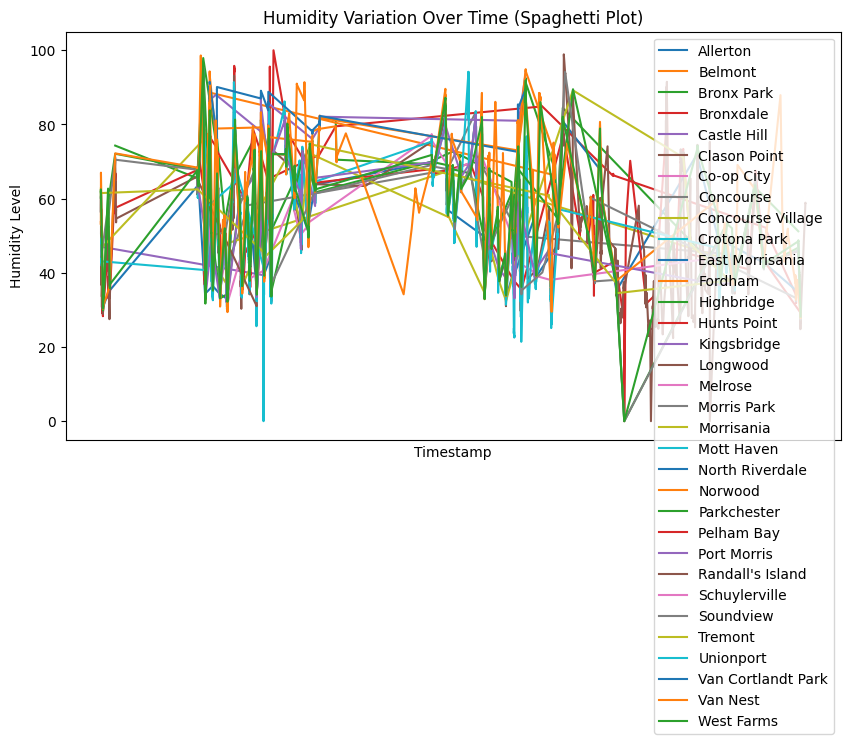

In [ ]:
# Plotting air quality data over time for each neighborhood
fig, ax = plt.subplots(figsize=(10, 6))
for neighborhood, group in merged_gdf.groupby('neighborhood_AQ'):
    group.plot(ax=ax, x='time', y='humidity', label=neighborhood, kind='line')
plt.xlabel('Timestamp')
plt.ylabel('Humidity Level')
plt.title('Humidity Variation Over Time (Spaghetti Plot)')
plt.legend()
plt.show()


Trip Duration Variation Over Time (Spaghetti Plot)

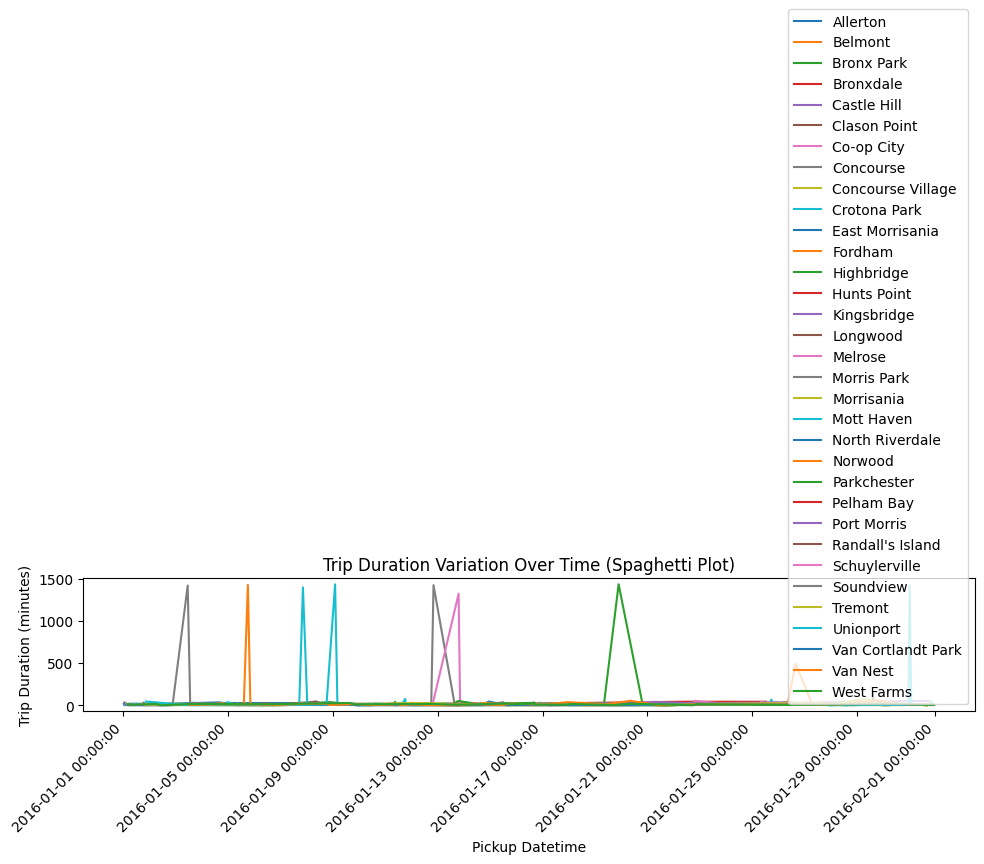

In [ ]:
# Convert 'lpep_pickup_datetime' and 'Lpep_dropoff_datetime' columns to datetime format
merged_gdf['lpep_pickup_datetime'] = pd.to_datetime(merged_gdf['lpep_pickup_datetime'])
merged_gdf['Lpep_dropoff_datetime'] = pd.to_datetime(merged_gdf['Lpep_dropoff_datetime'])

# Plotting mobility data over time for each neighborhood
fig, ax = plt.subplots(figsize=(10, 6))
for neighborhood, group in merged_gdf.groupby('neighborhood_mobility'):
    # Calculate the duration of each trip
    group['duration'] = (group['Lpep_dropoff_datetime'] - group['lpep_pickup_datetime']).dt.total_seconds() / 60.0
    group.plot(ax=ax, x='lpep_pickup_datetime', y='duration', label=neighborhood, kind='line')
plt.xlabel('Pickup Datetime')
plt.ylabel('Trip Duration (minutes)')
plt.title('Trip Duration Variation Over Time (Spaghetti Plot)')
plt.legend()

# Customize x-axis tick labels to show time
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
ax.xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%Y-%m-%d %H:%M:%S'))
plt.tight_layout()
plt.show()


Trip Duration versus PM2.5 Value using Spaghetti Plot

KeyError: 'duration'

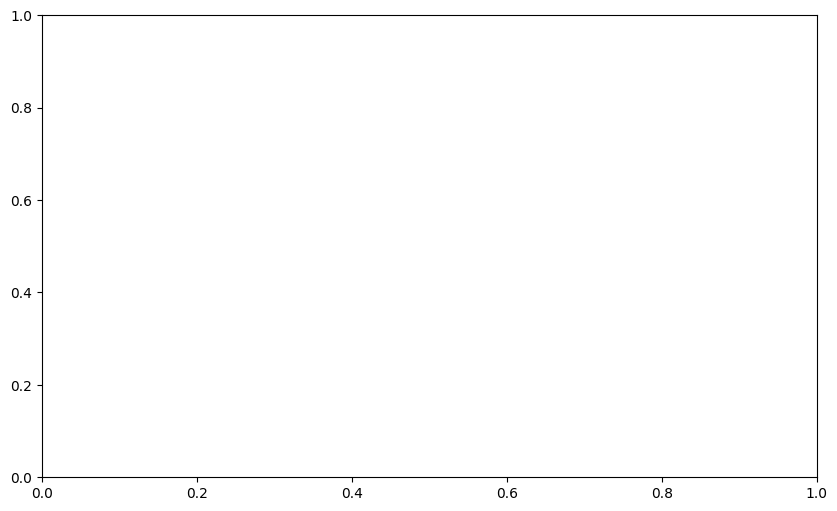

In [ ]:
# Plotting Trip Duration versus PM2.5 Value using Spaghetti Plot
fig, ax = plt.subplots(figsize=(10, 6))
for neighborhood, group in merged_gdf.groupby('neighborhood_mobility'):
    group.plot(ax=ax, x='pm25', y='duration', label=neighborhood, kind='line', alpha=0.5)

plt.xlabel('PM2.5 Value')
plt.ylabel('Trip Duration (minutes)')
plt.title('Trip Duration vs PM2.5 Value (Spaghetti Plot)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

Trip Duration versus Total Amount using Spaghetti Plot

In [ ]:
# Plotting Trip Duration versus Total Amount using Spaghetti Plot
fig, ax = plt.subplots(figsize=(10, 6))
for neighborhood, group in merged_gdf.groupby('neighborhood_mobility'):
    group.plot(ax=ax, x='Total_amount', y='duration', label=neighborhood, kind='line', alpha=0.5)

plt.xlabel('Total Amount')
plt.ylabel('Trip Duration (minutes)')
plt.title('Trip Duration vs Total Amount(Spaghetti Plot)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Spatial Autocorrelation


Exploratory Spatial Data Analysis (ESDA) is a set of techniques used to analyze and visualize spatial data in order to identify patterns, trends, and relationships that may exist in the data. It involves examining the characteristics of spatial data, such as geographic distributions, clustering, spatial autocorrelation, and spatial outliers.

Spatial Autocorrelation Analysis: ESDA often focuses on detecting spatial autocorrelation, which is the degree to which the value of a variable at one location is correlated with the value of the same variable at nearby locations. This analysis helps in understanding whether nearby locations are similar or dissimilar with respect to the variable being studied.

# installing required libraries


In [ ]:
pip install pandas geopandas pysal


In [ ]:
import pandas as pd
import geopandas as gpd
from pysal.explore import esda
from pysal.lib import weights
# Set CRS to EPSG:4326 if not already set
merged_gdf.crs = 'EPSG:4326'



#spatial weights

In [ ]:
# Construct a Queen's contiguity weights matrix
W = weights.Queen.from_dataframe(merged_gdf)
W.transform = 'r'  # Row-standardization of the weights


<ipython-input-250-d67e5c4ebe12>:2: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  W = weights.Queen.from_dataframe(merged_gdf)


In [ ]:
merged_gdf.head()

,SensorID,time,latitude_x,longitude_x,bin0,bin1,bin2,bin3,bin4,bin5,...,geometry_y,index_right_y,neighborhood_mobility,boroughCode_y,borough_y,@id_y,geometryn_y,air_quality,geometry,duration
0,NYCP2_CS01A,1632426780,40.844555,-73.871017,40,24,8,12,7,3,...,POINT (-73.87179 40.84233),292,Van Nest,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8222628.313 4988949.519, -8222962.1...",94,POINT (-73.87102 40.84455),10.900000
1,NYCP2_CS01A,1632426780,40.844555,-73.871017,40,24,8,12,7,3,...,POINT (-73.86959 40.84290),292,Van Nest,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8222628.313 4988949.519, -8222962.1...",94,POINT (-73.87102 40.84455),19.483333
2,NYCP2_CS01A,1632426780,40.844555,-73.871017,40,24,8,12,7,3,...,POINT (-73.86481 40.84543),292,Van Nest,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8222628.313 4988949.519, -8222962.1...",94,POINT (-73.87102 40.84455),8.150000
3,NYCP2_CS01A,1632807194,40.844788,-73.870979,62,8,3,0,0,1,...,POINT (-73.87179 40.84233),292,Van Nest,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8222628.313 4988949.519, -8222962.1...",74,POINT (-73.87098 40.84479),10.900000
4,NYCP2_CS01A,1632807194,40.844788,-73.870979,62,8,3,0,0,1,...,POINT (-73.86959 40.84290),292,Van Nest,2,Bronx,http://nyc.pediacities.com/Resource/Neighborho...,"POLYGON ((-8222628.313 4988949.519, -8222962.1...",74,POINT (-73.87098 40.84479),19.483333


In [ ]:

# Calculate Moran's I
moran = esda.Moran(merged_gdf['duration'], W)

# Print Moran's I value and p-value
print(f"Moran's I: {moran.I:.4f}")
print(f"P-value: {moran.p_norm:.4f}")


Moran's I: 0.0337
P-value: 0.0000


 A positive value indicates positive spatial autocorrelation (similar values near each other), while a negative value indicates dispersion.

Spatial Autocorrelation Test (Applying Global Moran's)

